# Raster Workflow

## How start working on raster data?

 **1. Read**

**2. plot and stat**

**3.Nan values**

**4.Normalize**

**5.Reduce noise**

**6. Check stats (mean, max,min, std)**

**7. reduce dimentions**

**8. Check endmembers and abundance of endmembers (NMF)**

**9. RF thresholding ? anomaly detection**

**10. cluster**


**11.RF classiifcation**




## Raster 

In [1]:
hyperspectral_path = r"C:\Users\sakbarpour\Downloads\Mufulira_Sentinel2.tif"


Text(0.5, 1.0, 'STD')

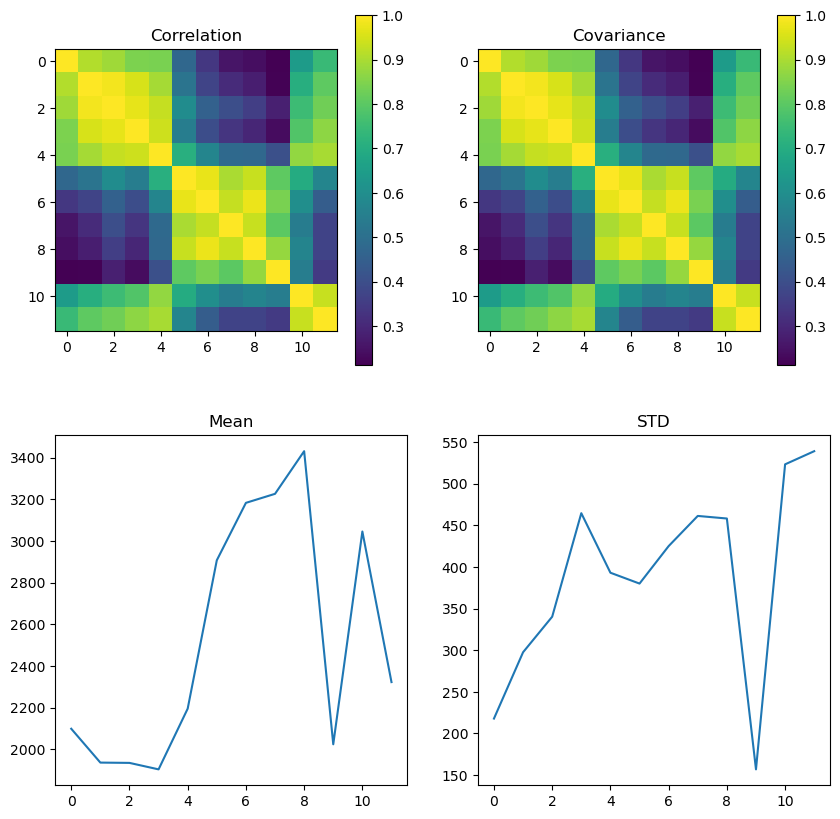

In [23]:
import numpy as np

corre=np.corrcoef(reshape_raster, rowvar=False)
cov=np.cov(reshape_raster, rowvar= False)
mean_raster=np.mean(raster_data, axis=(1,2))
std_raster=np.std(raster_data, axis=(1,2))


import matplotlib.pyplot as plt

fig , ax = plt.subplots(2,2, figsize=(10,10))
ax[0,0].imshow(corre)
ax[0,0].set_title('Correlation')
plt.colorbar(ax[0, 0].imshow(corre, cmap='viridis'), ax=ax[0, 0])

ax[0,1].imshow(cov)
ax[0,1].set_title('Covariance')
plt.colorbar(ax[0,1].imshow(corre, cmap='viridis'), ax=ax[0,1])

ax[1,0].plot(mean_raster)
ax[1,0].set_title('Mean')

ax[1,1].plot(std_raster)
ax[1,1].set_title('STD')


from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Assume raster_data and classified_raster are already defined
bands, height, width = raster_data.shape
labels = classified_raster

# Reshape data for LDA (samples x features)
reshaped_data = raster_data.reshape(bands, -1).T

# Perform LDA
lda_model = LDA(n_components=5)
lda_result = lda_model.fit_transform(reshaped_data, labels.ravel())

# Create a DataFrame for easy plotting with seaborn
import pandas as pd
lda_df = pd.DataFrame(lda_result, columns=[f'LDA{i+1}' for i in range(5)])
lda_df['Label'] = labels.ravel()

# Plot pairwise scatter plots
sns.pairplot(lda_df, hue='Label', palette='viridis', markers='.')
plt.suptitle('Pairwise Scatter Plots of LDA Components', y=1.02)
plt.show()





In [ ]:
# Reshape data for covariance calculation (samples x features)
reshaped_data = raster_data.reshape(bands, -1).T

# Calculate covariance matrix
cov_matrix = np.cov(reshaped_data, rowvar=False)
corr_matrix = np.corrcoef(reshaped_data, rowvar=False)
mean_spectral_signature = np.mean(raster_data, axis=(1, 2))
std_deviation_per_band = np.std(raster_data, axis=(1, 2))

# Import necessary libraries
import numpy as np
import matplotlib.pyplot as plt

# Assuming you have already computed these variables
# corr_matrix, cov_matrix, mean_spectral_signature, std_deviation_per_band

# Combine all plots in one figure
fig, axs = plt.subplots(2, 2, figsize=(15, 12))

# Plot 1: Correlation Matrix
axs[0, 0].imshow(corr_matrix, cmap='viridis')
axs[0, 0].set_title('Correlation Matrix')
axs[0, 0].set_xticks(np.arange(corr_matrix.shape[0]))
axs[0, 0].set_yticks(np.arange(corr_matrix.shape[1]))
axs[0, 0].set_xlabel('Band')
axs[0, 0].set_ylabel('Band')
plt.colorbar(axs[0, 0].imshow(corr_matrix, cmap='viridis'), ax=axs[0, 0])

# Plot 2: Covariance Matrix
axs[0, 1].imshow(cov_matrix, cmap='viridis')
axs[0, 1].set_title('Covariance Matrix')
axs[0, 1].set_xticks(np.arange(cov_matrix.shape[0]))
axs[0, 1].set_yticks(np.arange(cov_matrix.shape[1]))
axs[0, 1].set_xlabel('Band')
axs[0, 1].set_ylabel('Band')
plt.colorbar(axs[0, 1].imshow(cov_matrix, cmap='viridis'), ax=axs[0, 1])

# Plot 3: Mean Spectral Signature
axs[1, 0].plot(mean_spectral_signature)
axs[1, 0].set_title('Mean Spectral Signature')
axs[1, 0].set_xlabel('Band')
axs[1, 0].set_ylabel('Reflectance')

# Plot 4: Standard Deviation per Band
axs[1, 1].bar(np.arange(len(std_deviation_per_band)), std_deviation_per_band)
axs[1, 1].set_title('Standard Deviation per Band')
axs[1, 1].set_xlabel('Band')
axs[1, 1].set_ylabel('Standard Deviation')

# Adjust layout
plt.tight_layout()

# Show plot
plt.show()


Raster data shape: (12, 1001, 1001)


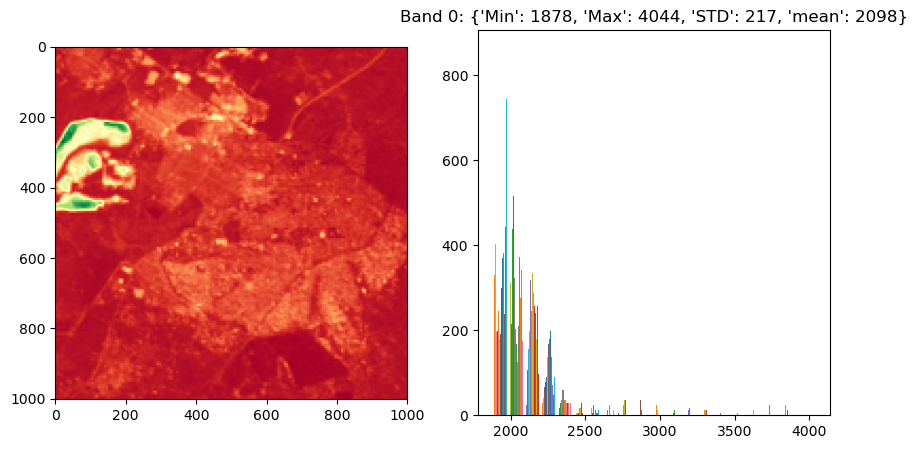

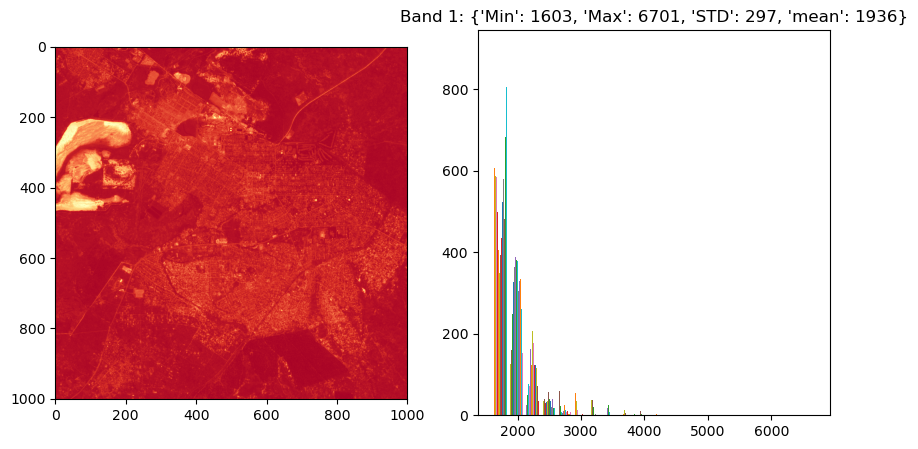

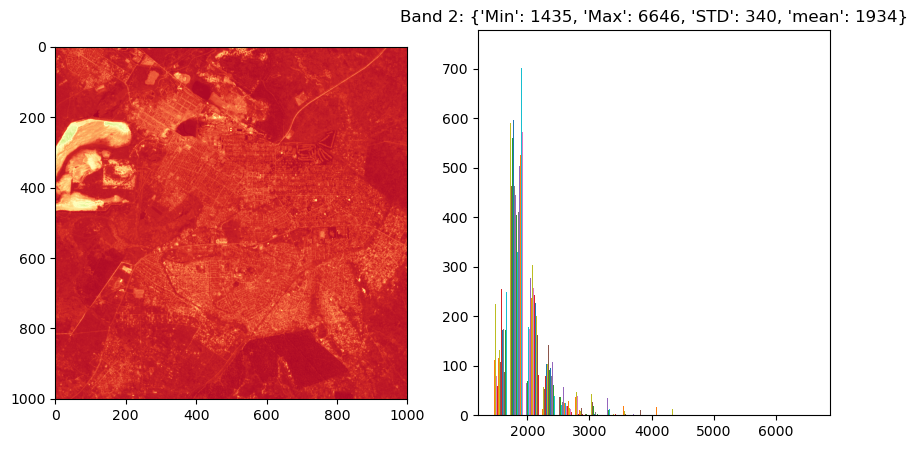

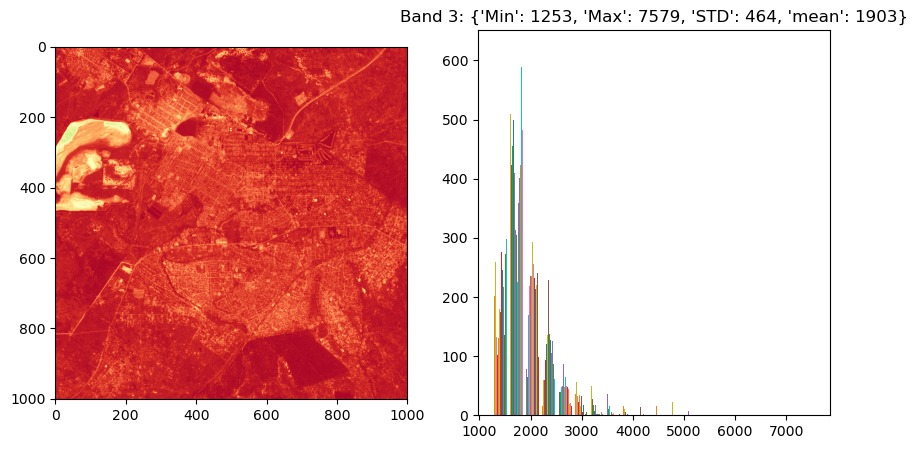

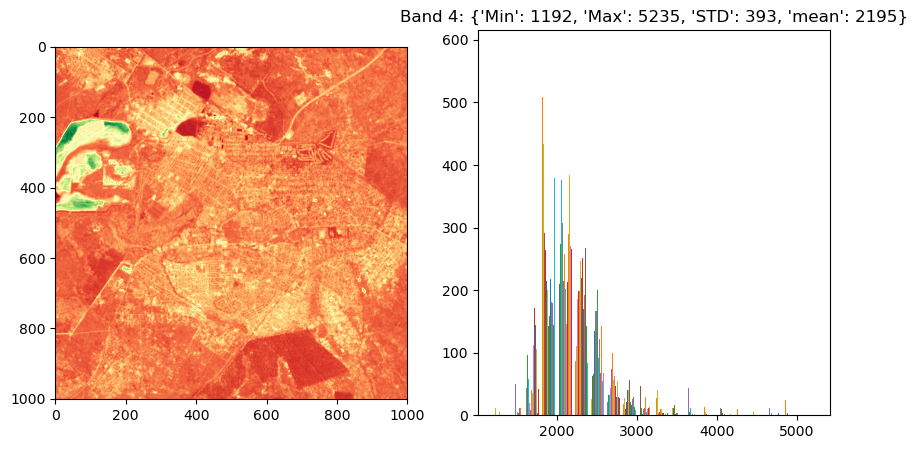

...

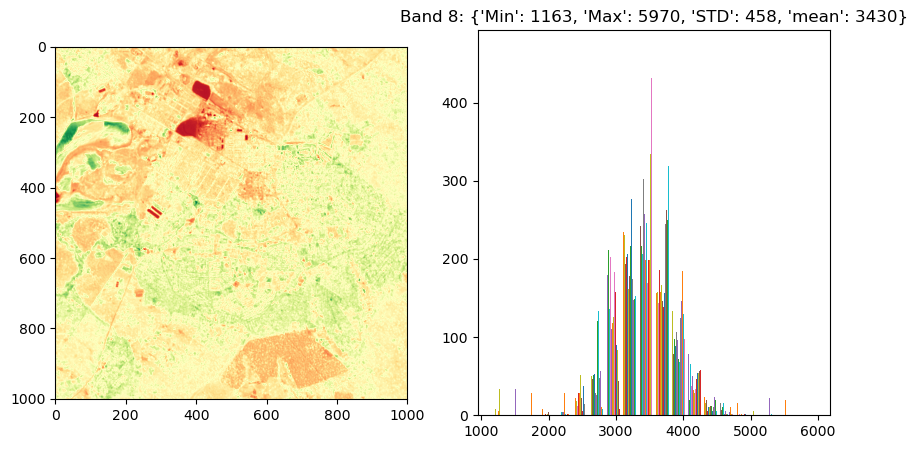

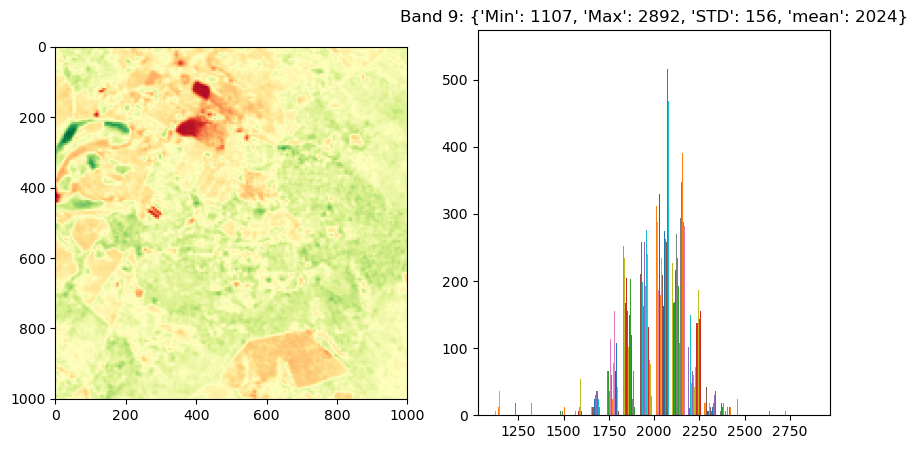

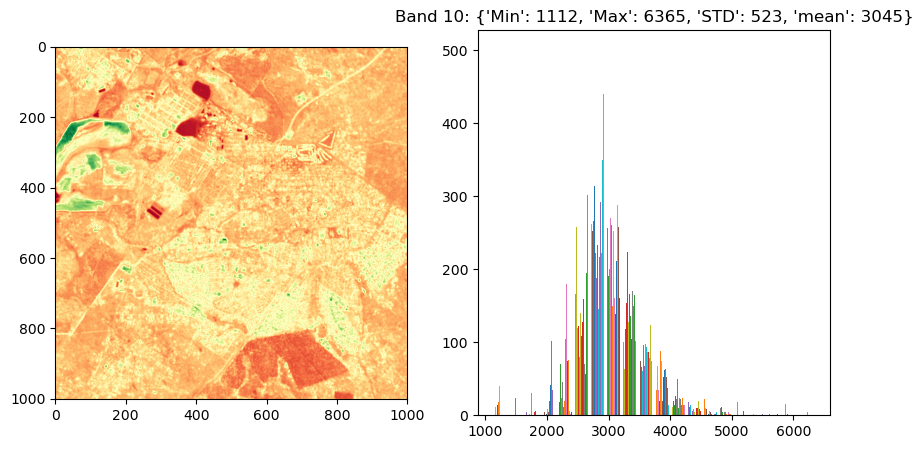

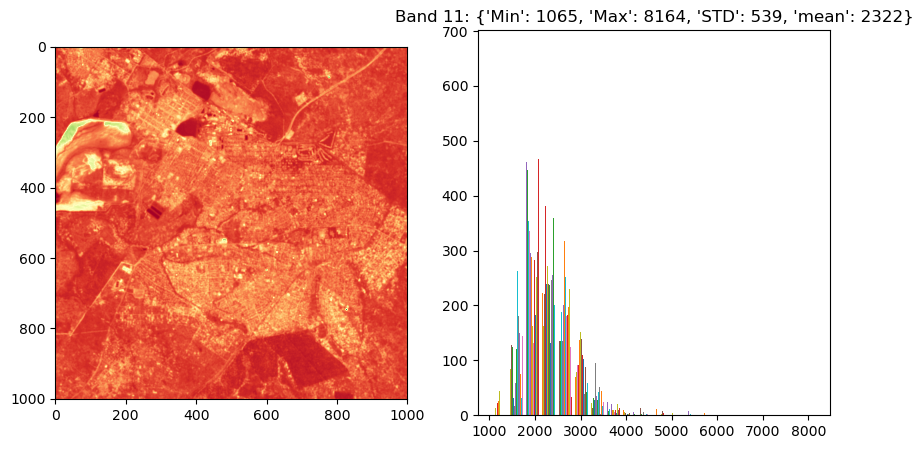

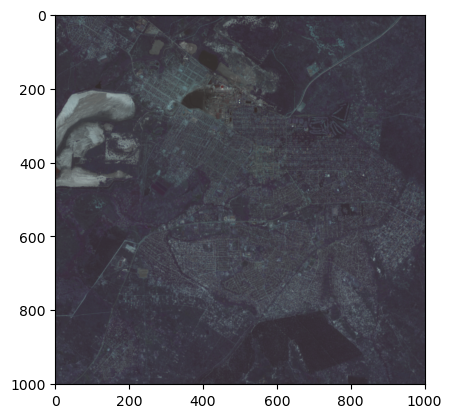

Standardized raster shape: (12, 1001, 1001)


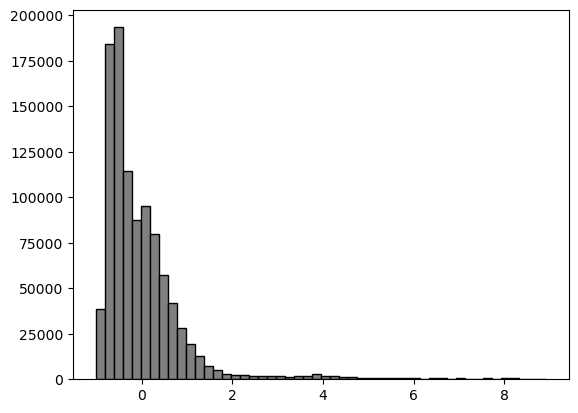

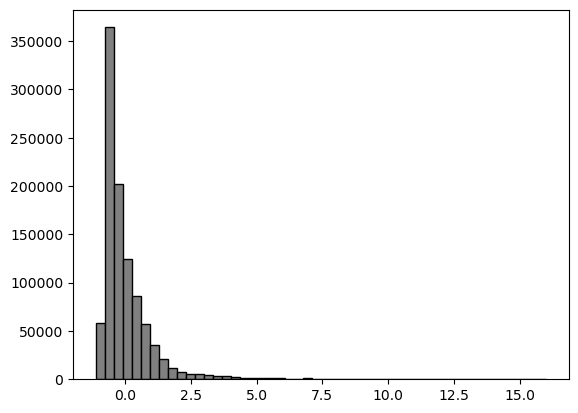

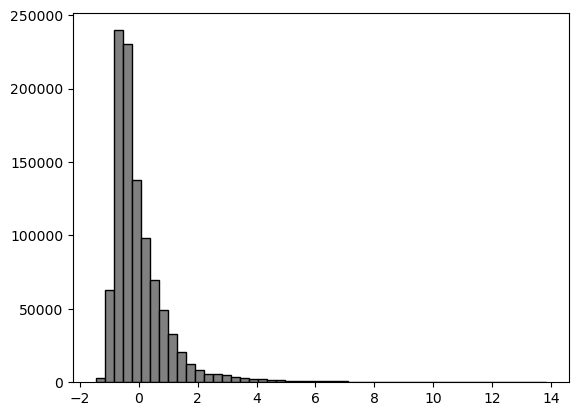

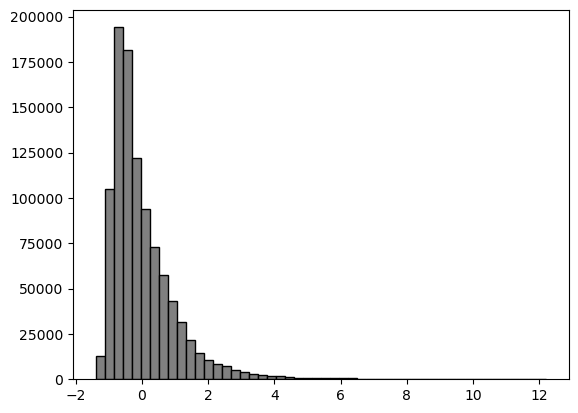

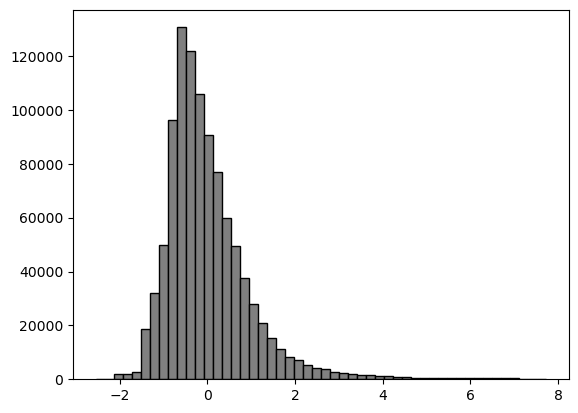

...

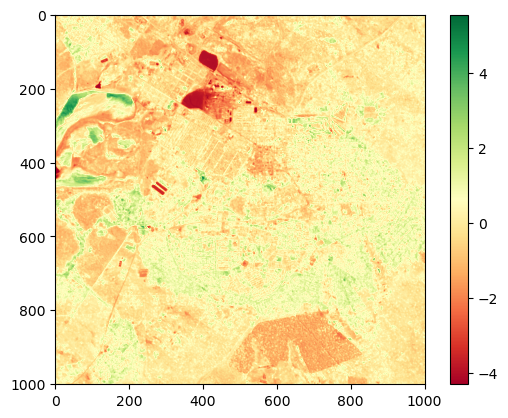

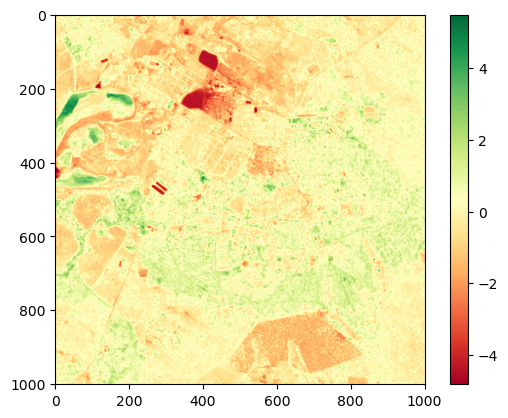

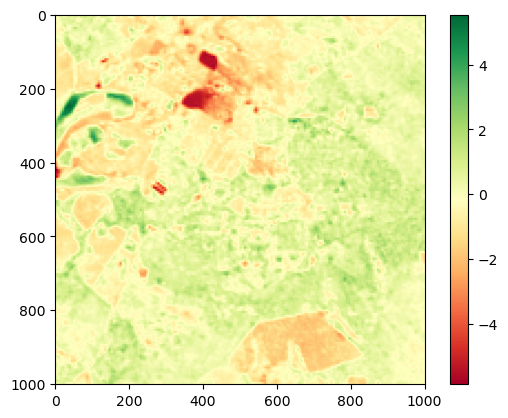

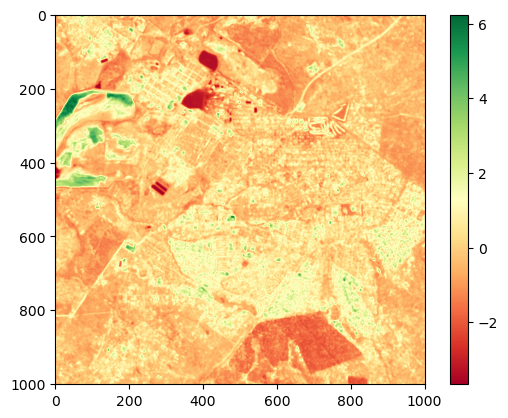

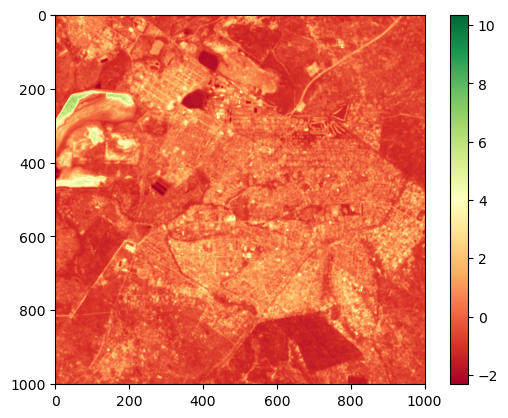

     Band_0    Band_1    Band_2    Band_3  X  Y
0  1.424261 -0.277100  1.671710  0.241169  0  0
1  1.076418 -0.300041  1.393632  0.057886  1  0
2  0.739265 -0.146317  1.575432 -0.107676  2  0
3 -0.529980  0.313166  0.753398 -0.428871  3  0
4 -0.589421  0.523652  0.791907 -0.371281  4  0


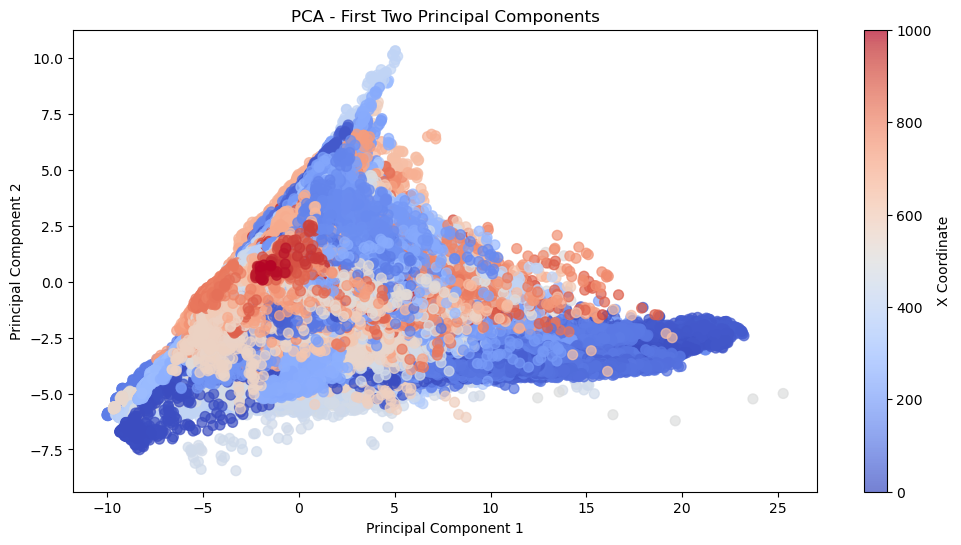

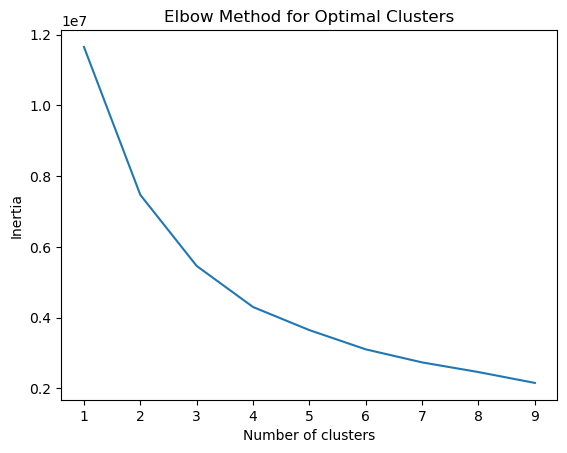

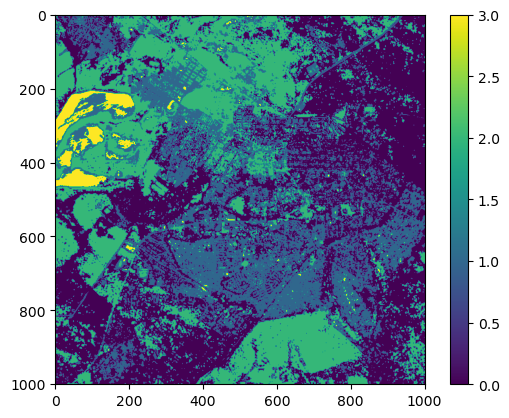

Accuracy: 0.99
Precision: 0.99
Recall: 0.99


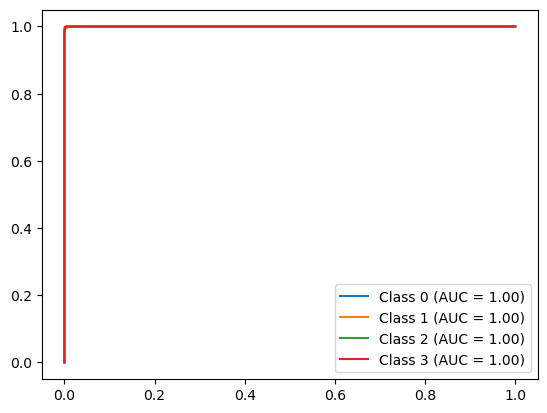

In [7]:
### Raster Data Analysis and Classification Workflow

import rasterio
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, roc_auc_score, accuracy_score, precision_score, recall_score
from sklearn.preprocessing import label_binarize
import scipy
from scipy.ndimage import median_filter

# 1. Read Raster Data
with rasterio.open(hyperspectral_path) as src:
    raster_data = src.read()  # Read all bands of the raster data
    print(f"Raster data shape: {raster_data.shape}")

# 2. Plot and Compute Statistics
for band in range(raster_data.shape[0]):
    band_raster = raster_data[band, :, :]  # Extract data for each band
    stat = {'Min': int(band_raster.min()), 'Max': int(band_raster.max()), 'STD': int(band_raster.std()), 'mean': int(band_raster.mean())}
    
    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].imshow(band_raster, cmap='RdYlGn')  # Display the band image
    ax[1].hist(band_raster, bins=20)  # Display histogram of pixel values
    ax[1].set_title(f"Band {band}: {stat}")  # Show statistics
    plt.show()

# Create an RGB image from selected bands
rgb_image = np.stack(raster_data[2:5, :, :], axis=-1)
rgb_image = rgb_image / rgb_image.max()  # Normalize
plt.imshow(rgb_image)
plt.show()

# 3. Handle NA Values
interpolate_raster = np.zeros_like(raster_data)
for band in range(raster_data.shape[0]):
    band_raster = raster_data[band, :, :]
    mask_na = np.isnan(band_raster)  # Identify NA values
    band_raster[mask_na] = band_raster.mean()  # Replace NA values with mean
    interpolate_raster[band, :, :] = band_raster

# 4. Standardize the Raster Data
scale = StandardScaler()
standardized_raster_array = scale.fit_transform(raster_data.reshape(raster_data.shape[0], -1).T)
standardized_raster = standardized_raster_array.T.reshape(raster_data.shape)
print(f"Standardized raster shape: {standardized_raster.shape}")

# Plot histogram of standardized data
for band in range(standardized_raster.shape[0]):
    plt.hist(standardized_raster[band, :, :].ravel(), bins=50, color='gray', edgecolor='black')
    plt.show()

# 5. Apply Filtering
filtered_raster = np.array([median_filter(band, size=3) for band in standardized_raster])
for band in range(filtered_raster.shape[0]):
    plt.imshow(filtered_raster[band, :, :], cmap='RdYlGn')
    plt.colorbar()
    plt.show()

# 6. Principal Component Analysis (PCA)
pca = PCA(n_components=4)
reduce_raster_array = pca.fit_transform(standardized_raster.reshape(standardized_raster.shape[0], -1).T)
reduce_raster = reduce_raster_array.T.reshape(4, standardized_raster.shape[1], standardized_raster.shape[2])

# Prepare data for plotting
bands, rows, cols = reduce_raster.shape
data = reduce_raster.reshape(bands, -1).T  # Flatten the raster data
x_coords, y_coords = np.meshgrid(np.arange(cols), np.arange(rows))
x_coords = x_coords.flatten()
y_coords = y_coords.flatten()
df = pd.DataFrame(data, columns=[f'Band_{i}' for i in range(bands)])
df['X'] = x_coords
df['Y'] = y_coords
print(df.head())

# Plot the first two principal components
plt.figure(figsize=(12, 6))
plt.scatter(df['Band_0'], df['Band_1'], c=df['X'], cmap='coolwarm', s=50, alpha=0.7)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA - First Two Principal Components')
plt.colorbar(label='X Coordinate')
plt.show()

# 7. K-Means Clustering
kmean_cluster = []
for cluster in range(1, 10):
    kmeans = KMeans(n_clusters=cluster)
    kmeans.fit_predict(reduce_raster.reshape(4, -1).T)
    kmean_cluster.append(kmeans.inertia_)

# Plot the inertia for different cluster numbers
plt.plot(range(1, 10), kmean_cluster)
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.title('Elbow Method for Optimal Clusters')
plt.show()

# Perform K-Means clustering with a chosen number of clusters
kmeans = KMeans(n_clusters=4)
kmeans_cluster = kmeans.fit_predict(reduce_raster.reshape(4, -1).T)
plt.imshow(kmeans_cluster.reshape(reduce_raster.shape[1], reduce_raster.shape[2]))
plt.colorbar()
plt.show()

# 8. Classification with Random Forest
labels = kmeans_cluster
X_train, X_test, Y_train, Y_test = train_test_split(reduce_raster.reshape(4, -1).T, labels, test_size=0.9)
rf = RandomForestClassifier()
rf.fit(X_train, Y_train)

# Predict and evaluate
y_pred = rf.predict(X_test)
y_proba = rf.predict_proba(X_test)
accuracy = accuracy_score(Y_test, y_pred)
precision = precision_score(Y_test, y_pred, average='weighted')
recall = recall_score(Y_test, y_pred, average='weighted')

print(f"Accuracy: {accuracy:.2f}")
print(f"Precision: {precision:.2f}")
print(f"Recall: {recall:.2f}")

# ROC Curve
y_test_binarize = label_binarize(Y_test, classes=np.unique(Y_test))
n_classes = y_test_binarize.shape[1]
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_binarize[:, i], y_proba[:, i])
    roc_auc[i] = roc_auc_score(y_test_binarize[:, i], y_proba[:, i])

# Plot ROC curve
plt.figure()
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc[i]:.2f})')
plt.legend()
plt.show()


In [ ]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

bands, height, width = raster_data.shape
labels = cluster_predicted

reshaped_data = raster_data.reshape(bands, -1).T

pca_model = PCA(n_components=5)
pca_result = pca_model.fit_transform(reshaped_data, labels.ravel())

# Create a DataFrame for easy plotting with seaborn
import pandas as pd
pca_df = pd.DataFrame(pca_result, columns=[f'PCA{i+1}' for i in range(5)])
pca_df['Label'] = labels.ravel()

# Plot pairwise scatter plots
sns.pairplot(lda_df, hue='Label', palette='viridis', markers='.')
plt.suptitle('Pairwise Scatter Plots of PCA Components', y=1.02)
plt.show()


### Step by step

1878


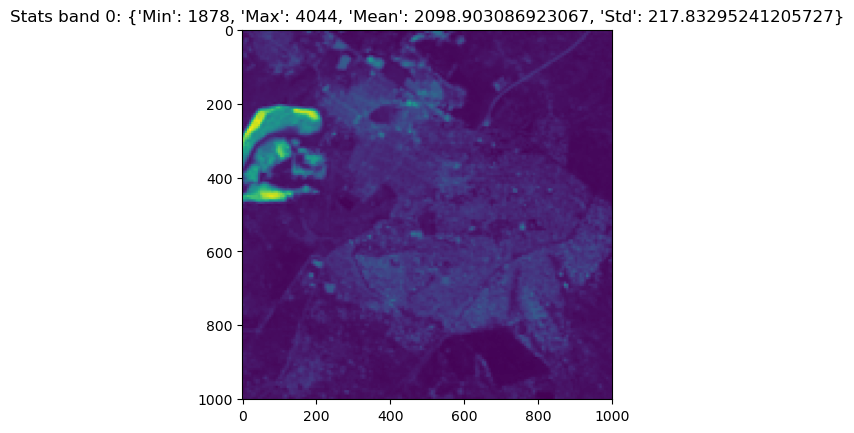

1603


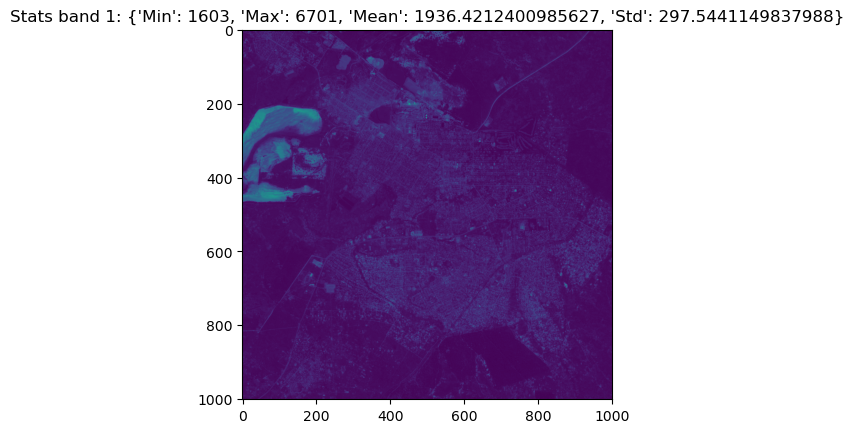

1435


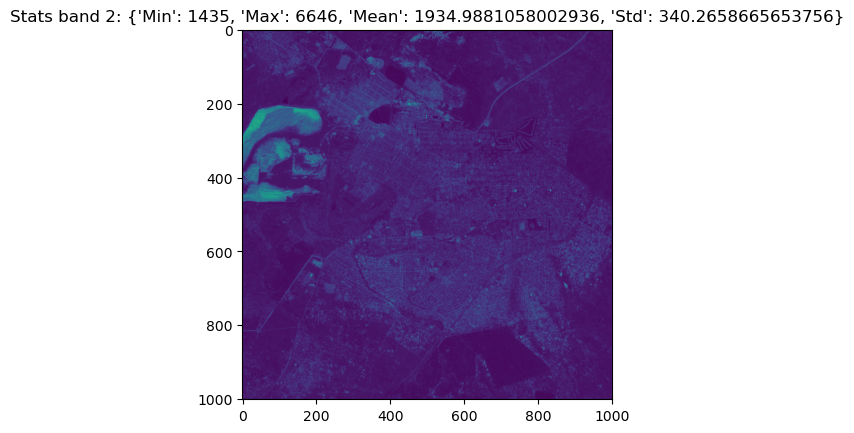

1253


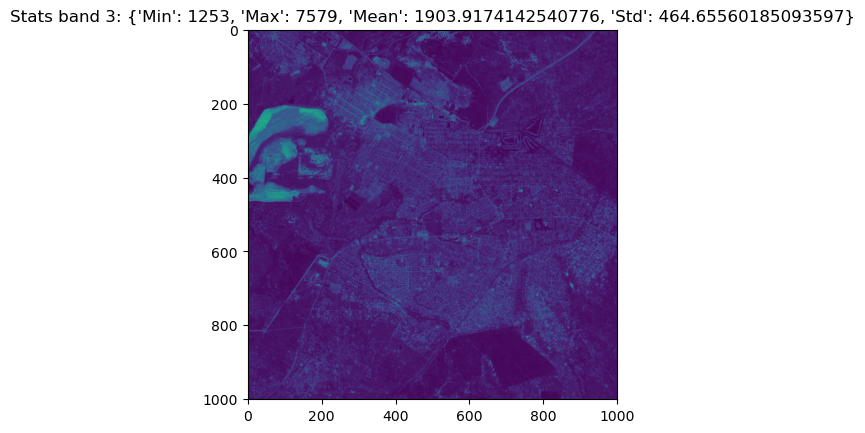

1192


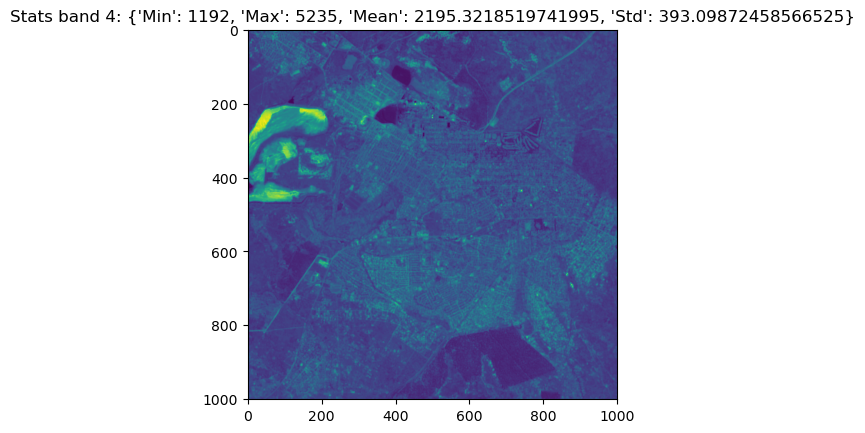

1231


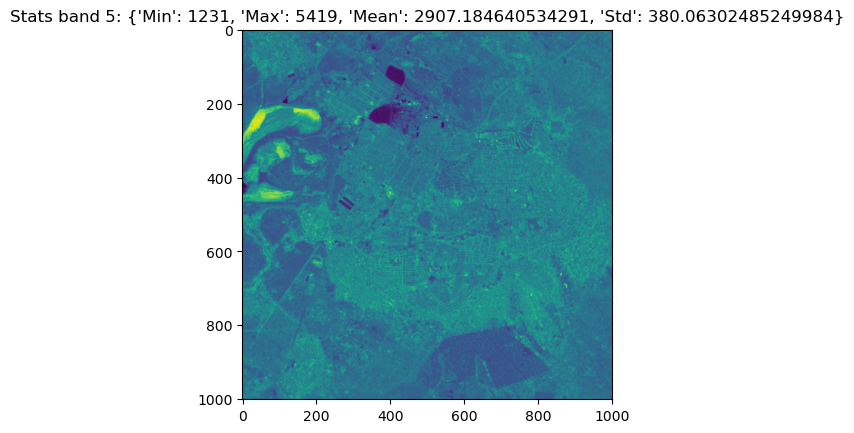

1195


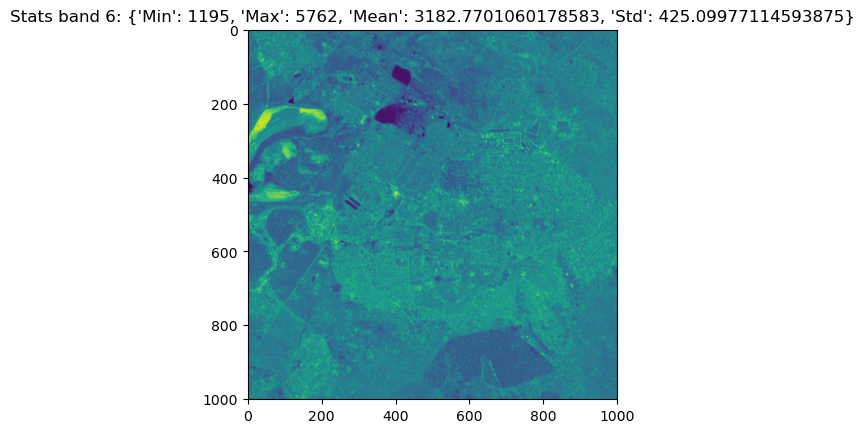

1223


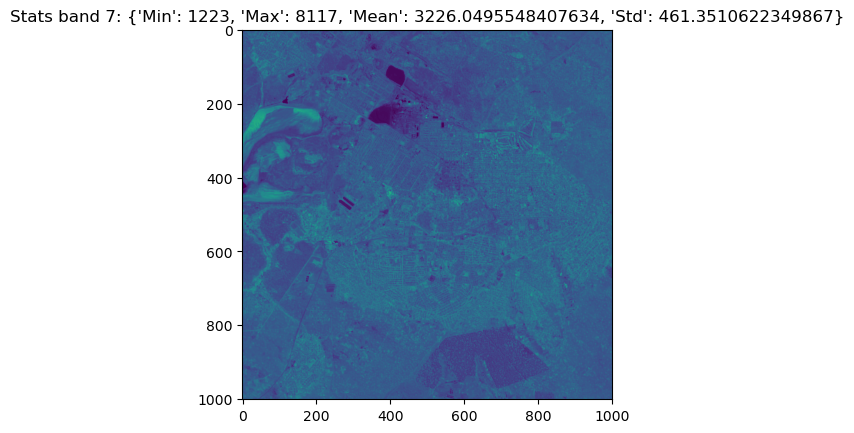

1163


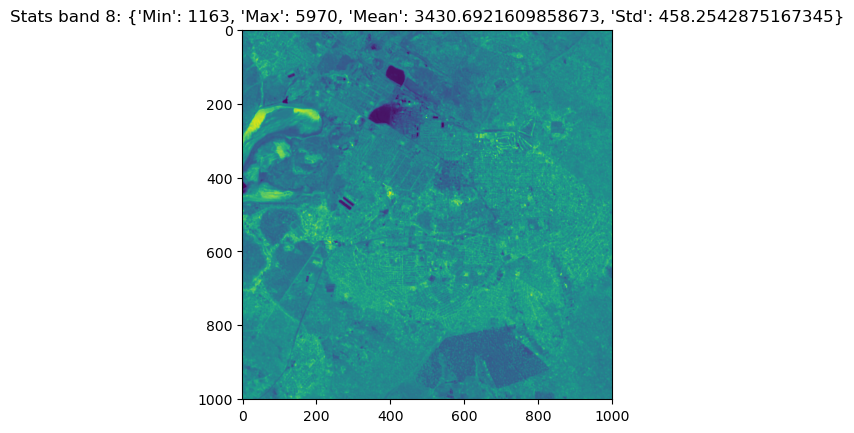

1107


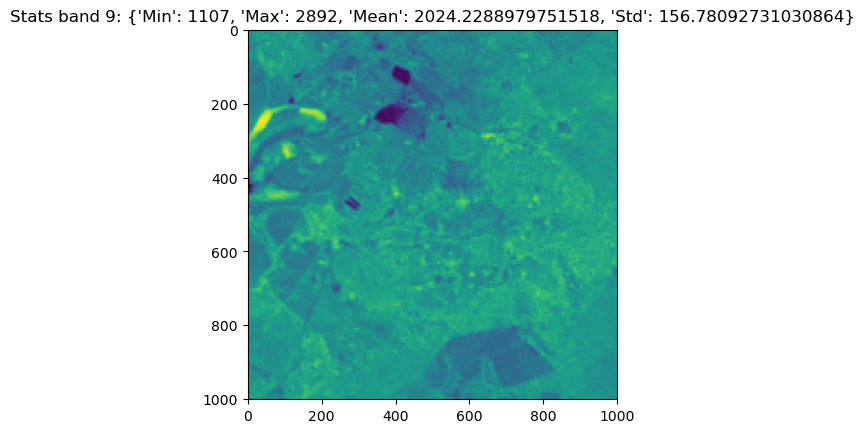

1112


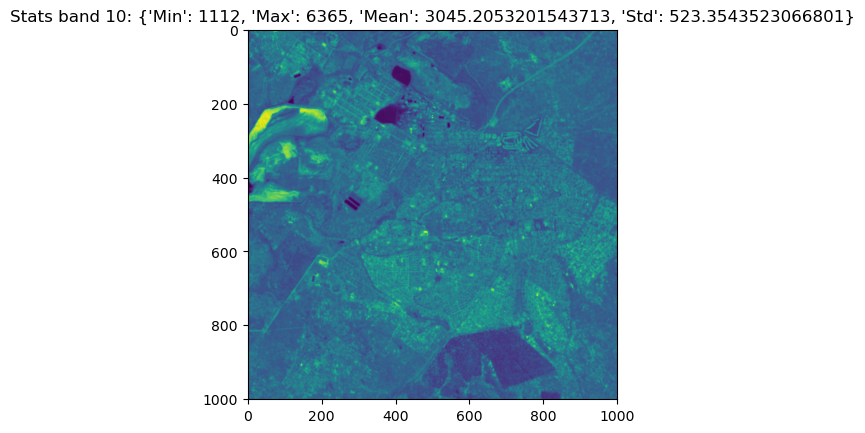

1065


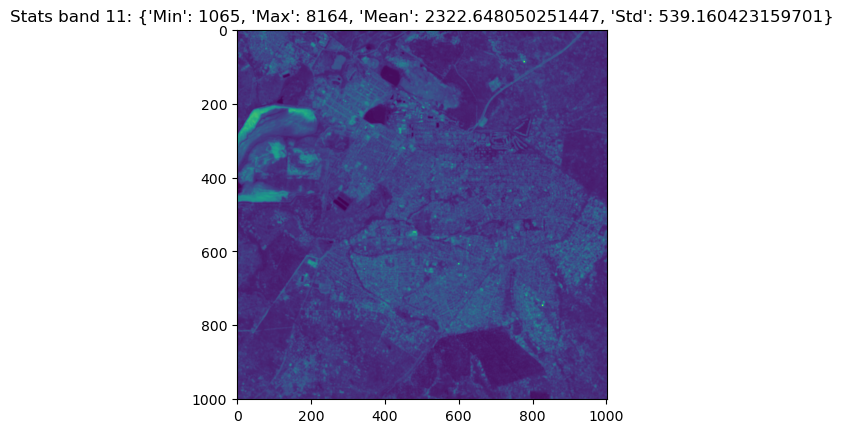

In [184]:
import rasterio
from osgeo import gdal

with rasterio.open(hyperspectral_path) as scr:
    raster_data=scr.read()

bands , height, width= raster_data.shape
for band in range(bands):
    rasterband= raster_data[band, :,:]
    print(rasterband.min())
    statbands= {'Min': rasterband.min(),
                'Max': rasterband.max(),
                'Mean': rasterband.mean(),
                'Std': rasterband.std()}
    plt.imshow(rasterband)
    plt.title(f"Stats band {band}: {statbands}")
    plt.show()

-2.2175799750236784 13.529121717055267 0.9999999999999999
-1.9295417373812387 9.557806263861199 0.9205139664677963
-1.7565150803969976 5.920290544579388 0.8372817415390452


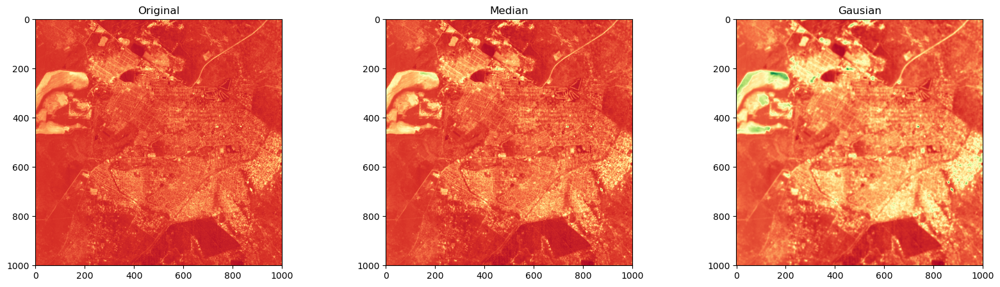

In [188]:
#remove nan
import numpy as np
reshape_raster= raster_data.reshape(12, -1).T
  ##Interpolate

interpolate_nan_raster= np.zeros_like(raster_data)
for band in range(12):
    band_raster= raster_data[band, :,:]
    mask=np.isnan(band_raster)
    band_raster[mask]=np.mean(band_raster)
    interpolate_nan_raster[band]=band_raster


# Normalized raster 

from sklearn.preprocessing import StandardScaler

scale=StandardScaler()
normalized_raster=np.array([scale.fit_transform(band) for band in interpolate_nan_raster])



# remove noise
import scipy
from scipy.ndimage import gaussian_filter
from scipy.ndimage import median_filter

median_filter_raster= np.array([scipy.ndimage.median_filter(band, size=3) for band in normalized_raster])
gaussian_filter_raster=np.array([scipy.ndimage.gaussian_filter(band, sigma=2) for band in normalized_raster])

fig, axs= plt.subplots(1,3, figsize=(20,5))
axs[0].imshow(normalized_raster[2,:,:], cmap='RdYlGn')
axs[0].set_title("Original")

print(normalized_raster[2,:,:].min(), normalized_raster[2,:,:].max(), normalized_raster[2,:,:].std())

axs[1].imshow(median_filter_raster[2,:,:], cmap='RdYlGn')
axs[1].set_title("Median")
print(median_filter_raster[2,:,:].min(), median_filter_raster[2,:,:].max(), median_filter_raster[2,:,:].std())
axs[2].imshow(gaussian_filter_raster[2,:,:], cmap='RdYlGn')
axs[2].set_title("Gausian")
print(gaussian_filter_raster[2,:,:].min(), gaussian_filter_raster[2,:,:].max(), gaussian_filter_raster[2,:,:].std())


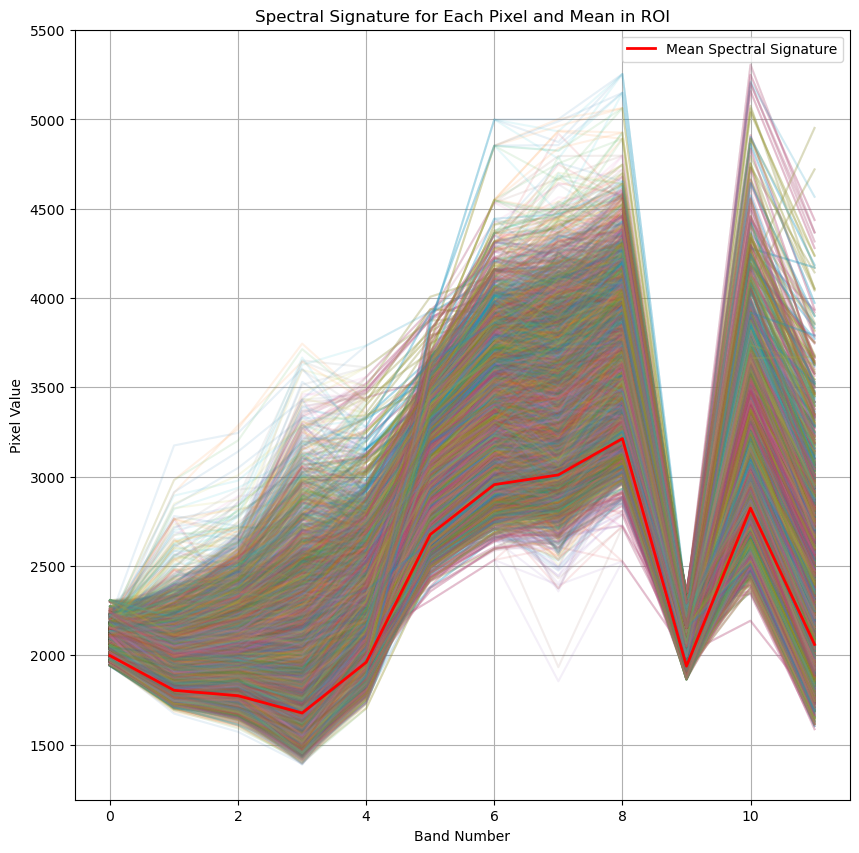

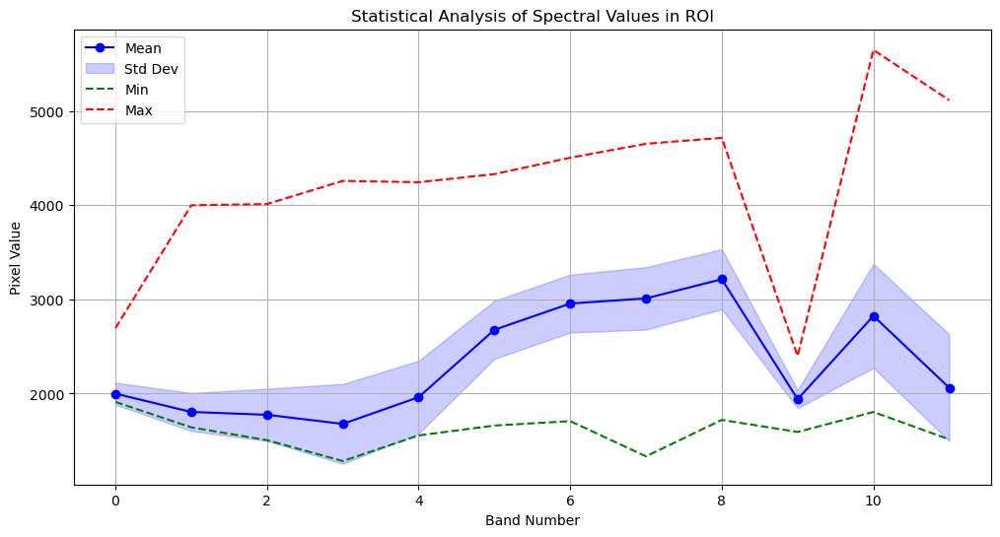

In [189]:
import matplotlib.pyplot as  plt

mean_values= np.mean(raster_data[:, 600:700, 100:200], axis=(1,2))
max_raster=np.max(raster_data[:, 600:700, 100:200], axis=(1,2))
std_values = np.std(raster_data[:, 600:700, 100:200], axis=(1, 2))
min_values = np.min(raster_data[:, 600:700, 100:200], axis=(1, 2))
max_values = np.max(raster_data[:, 600:700, 100:200], axis=(1, 2))

plt.figure(figsize=(10,10))
bands = np.arange(raster_data.shape[0])


for i in range(700 - 600):
    for j in range(200 - 100):
        plt.plot(bands, raster_data[:, i, j], alpha=0.1)

# Plot the mean spectral signature

plt.plot(bands, mean_values, color='red', linewidth=2, label='Mean Spectral Signature')

# Set labels and title
plt.xlabel('Band Number')
plt.ylabel('Pixel Value')
plt.title('Spectral Signature for Each Pixel and Mean in ROI')
plt.legend()
plt.grid(True)
plt.show()

# Plot statistics for each band
plt.figure(figsize=(12, 6))

plt.plot(bands, mean_values, label='Mean', color='blue', marker='o')
plt.fill_between(bands, mean_values - std_values, mean_values + std_values, color='blue', alpha=0.2, label='Std Dev')
plt.plot(bands, min_values, label='Min', color='green', linestyle='--')
plt.plot(bands, max_values, label='Max', color='red', linestyle='--')

# Set labels and title
plt.xlabel('Band Number')
plt.ylabel('Pixel Value')
plt.title('Statistical Analysis of Spectral Values in ROI')
plt.legend()
plt.grid(True)
plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


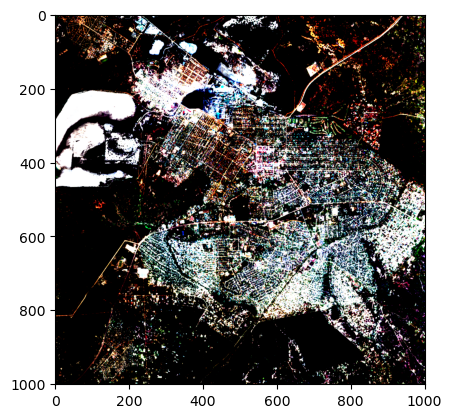

In [190]:
rgb_image=np.dstack((normalized_raster[3], normalized_raster[2], normalized_raster[1]))
plt.imshow(rgb_image)

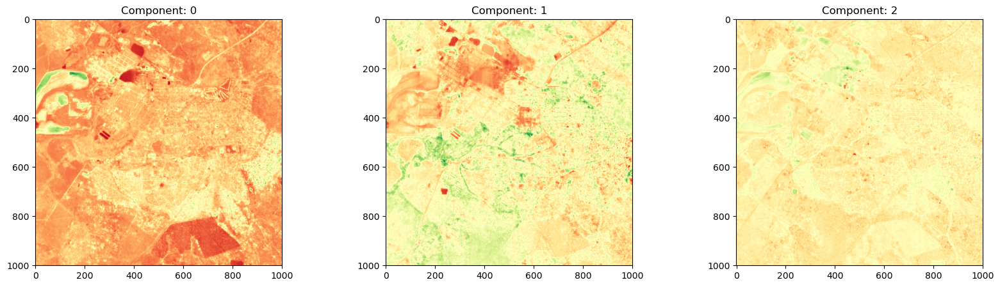

In [191]:
from sklearn.decomposition import PCA
reshape_raster= median_filter_raster.reshape(12, -1).T
pca=PCA(n_components=3)
pca_raster_bands=pca.fit_transform(reshape_raster)
pca_raster=pca_raster_bands.T.reshape(3, height,width)
fig, axis=plt.subplots(1, pca_raster.shape[0],  figsize=(20, 5))
for i in range(pca_raster.shape[0]):
    axis[i].imshow(pca_raster[i,:,:], cmap="RdYlGn")
    axis[i].set_title(f"Component: {i}")
plt.show()


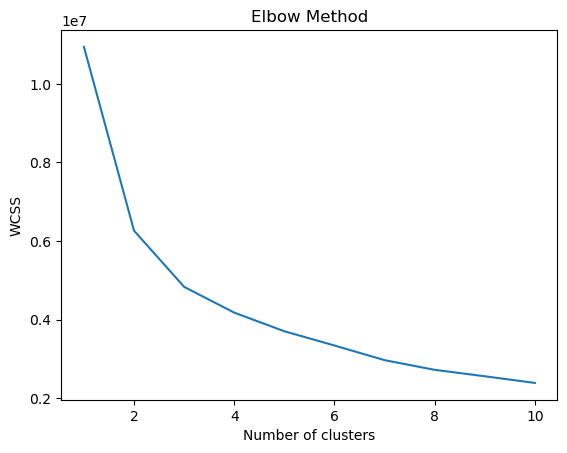

In [194]:
k_means=[]
for k in range(1, 11):
    kmeans=KMeans(n_clusters=k)
    kmeans.fit_predict(median_filter_raster.reshape(3, -1).T)
    k_means.append(kmeans.inertia_)

plt.plot(range(1,11), k_means)
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'Clustered')

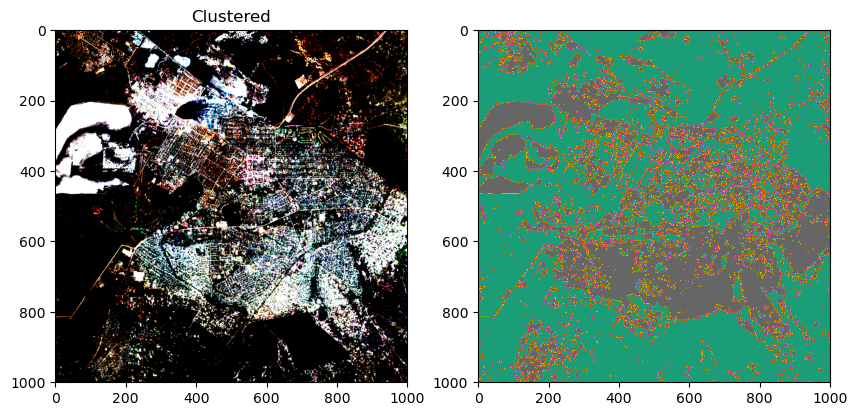

In [193]:
from sklearn.cluster import KMeans
reshaped_raster= pca_raster.reshape(3, -1).T
kmeans= KMeans(n_clusters=2)
cluster_2d=kmeans.fit_predict(reshaped_raster)
kmeans_raster=cluster_2d.reshape(height, width)
fig, axs= plt.subplots(1, 2, figsize=(10,5))
axs[0].imshow(rgb_image)
axs[0].set_title('RGB image')
axs[1].imshow(kmeans_raster, cmap="Dark2")
axs[0].set_title('Clustered')


#### Endmembers:


Definition: Endmembers are pure spectral signatures or spectra that represent the purest form of materials present in a hyperspectral image. Each endmember corresponds to a specific material or class.

Role: Endmembers act as the reference spectra against which the mixed spectra of pixels are compared. They are the building blocks of the mixed spectral signals observed in hyperspectral data.

Extraction: Techniques like Non-negative Matrix Factorization (NMF), Principal Component Analysis (PCA), Vertex Component Analysis (VCA), and others can be used to extract endmembers from hyperspectral data.

Characteristics: Endmembers have high spectral purity and distinct spectral features that distinguish them from other materials.

Abundances:

Definition: Abundances are the proportions or fractions of endmembers present in a mixed pixel. Each pixel in a hyperspectral image is often a mixture of several endmembers, and the abundance values represent the contribution of each endmember to the mixed pixel’s spectrum.

Role: Abundances quantify the presence of each endmember within a pixel. They are used to determine the composition of materials within each pixel of the hyperspectral image.

Calculation: Abundances are calculated through spectral unmixing techniques that decompose the observed spectral signature of a pixel into a linear or non-linear combination of endmember spectra.

Constraints: In many unmixing methods, abundances are subject to constraints such as non-negativity (abundance values cannot be negative) and sum-to-one (the sum of all abundance values for a pixel should be 1).

Relationship between Endmembers and Abundances:

Spectral Mixing Model: The observed spectral signature of a pixel is modeled as a combination of endmember spectra weighted by their corresponding abundance values. In a linear mixing model, this relationship can be expressed as:


𝑦=𝐸⋅𝑎+𝑛
y=E⋅a+n

where:
𝑦
y is the observed spectral signature of a pixel.
𝐸
E is the matrix of endmember spectra.
𝑎
a is the vector of abundance values.
𝑛
n is the noise or error term.
Interpretation: By decomposing the observed spectral signature into endmembers and their abundances, we can interpret the material composition of each pixel in terms of the presence and proportions of different materials.
Example Illustration:
Imagine a hyperspectral image of a forested area. Endmembers might include:

Tree leaves: Spectral signature of pure leaf material.
Soil: Spectral signature of bare soil.
Water: Spectral signature of water bodies.
Each pixel in the hyperspectral image might be a mixture of these endmembers. Abundances will indicate how much of each endmember (tree leaves, soil, water) is present in that pixel. For example:

Pixel 1: 70% tree leaves, 20% soil, 10% water.
Pixel 2: 50% tree leaves, 50% soil, 0% water.

Visualization:

Endmembers Plot: This plot provides an understanding of the spectral characteristics of each endmember.
Abundance Maps: These maps show the spatial distribution of each endmember, allowing for the analysis of where each material is predominantly located in the image.

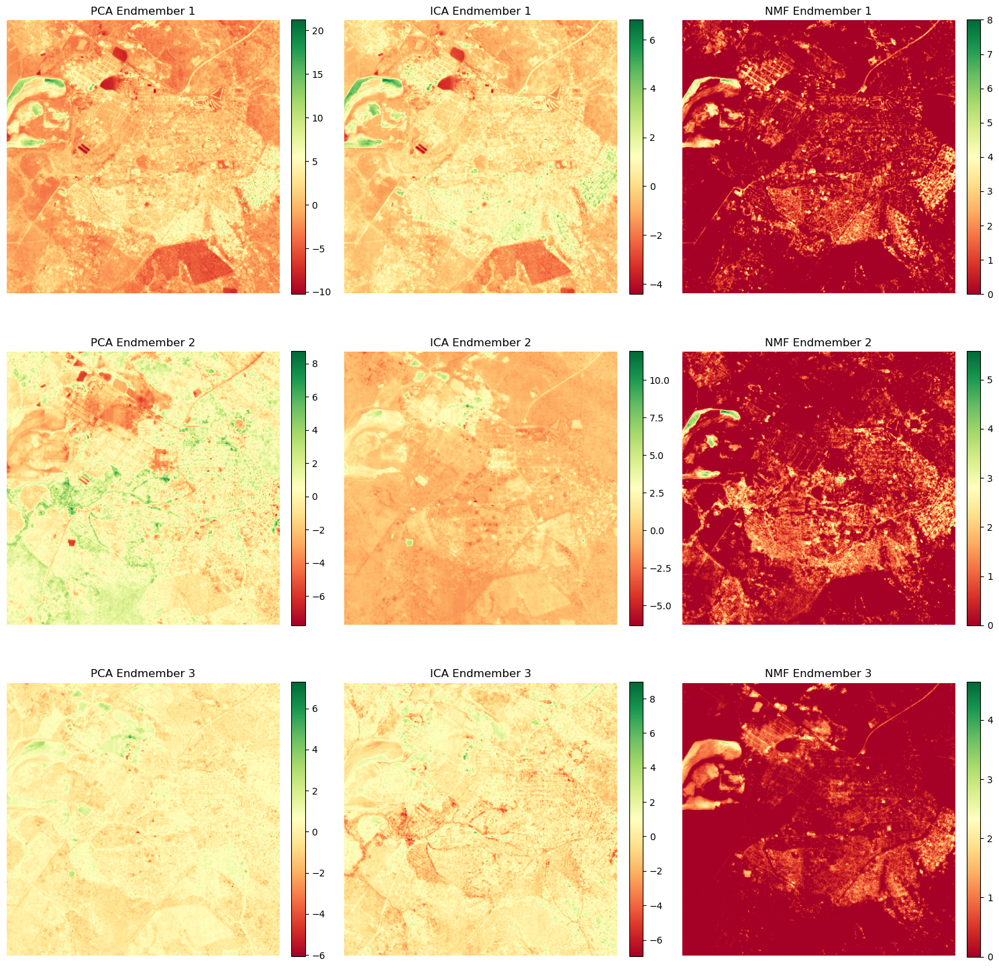

In [129]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA, FastICA, NMF
from scipy.stats import describe

# Assuming `normalized_raster` is a 3D numpy array with shape (bands, height, width)
bands, height, width = median_filter_raster.shape
reshaped_raster = median_filter_raster.reshape(bands, height * width).T  # Reshape for PCA/ICA/NMF

# Perform PCA
pca = PCA(n_components=3)  # Choose the number of endmembers
pca_endmembers = pca.fit_transform(reshaped_raster)

# Perform ICA
ica = FastICA(n_components=3)  # Choose the number of endmembers
ica_endmembers = ica.fit_transform(reshaped_raster)

# Perform NMF
reshaped_raster=np.maximum(reshaped_raster,0)
nmf = NMF(n_components=3, init='random', random_state=0)
nmf_endmembers = nmf.fit_transform(reshaped_raster)

# Reshape back to original spatial dimensions for visualization
pca_endmembers_reshaped = pca_endmembers.T.reshape(3, height, width)
ica_endmembers_reshaped = ica_endmembers.T.reshape(3, height, width)
nmf_endmembers_reshaped = nmf_endmembers.T.reshape(3, height, width)

fig, axes = plt.subplots(3, 3, figsize=(15, 15))
cmap = 'RdYlGn'
titles = ['PCA', 'ICA', 'NMF']

for i in range(3):
    axes[i, 0].imshow(pca_endmembers_reshaped[i], cmap=cmap)
    axes[i, 0].set_title(f'PCA Endmember {i+1}')
    axes[i, 0].axis('off')
    fig.colorbar(axes[i, 0].imshow(pca_endmembers_reshaped[i], cmap=cmap), ax=axes[i, 0], fraction=0.046, pad=0.04)

    axes[i, 1].imshow(ica_endmembers_reshaped[i], cmap=cmap)
    axes[i, 1].set_title(f'ICA Endmember {i+1}')
    axes[i, 1].axis('off')
    fig.colorbar(axes[i, 1].imshow(ica_endmembers_reshaped[i], cmap=cmap), ax=axes[i, 1], fraction=0.046, pad=0.04)

    axes[i, 2].imshow(nmf_endmembers_reshaped[i], cmap=cmap)
    axes[i, 2].set_title(f'NMF Endmember {i+1}')
    axes[i, 2].axis('off')
    fig.colorbar(axes[i, 2].imshow(nmf_endmembers_reshaped[i], cmap=cmap), ax=axes[i, 2], fraction=0.046, pad=0.04)

plt.tight_layout()
plt.show()

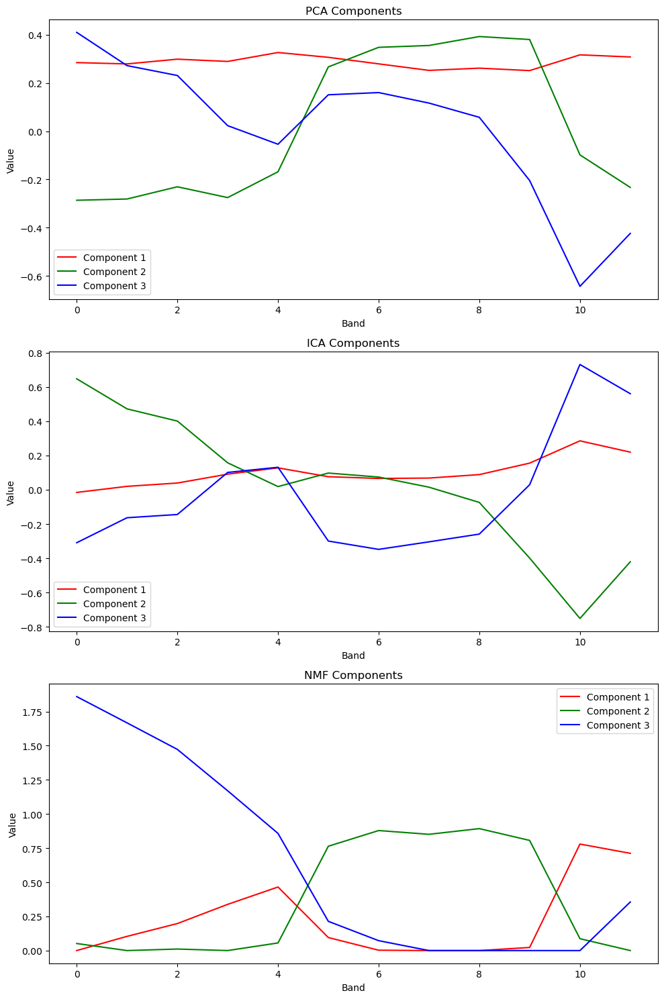

In [130]:
# Plot all components of each method in one plot
fig, axes = plt.subplots(3, 1, figsize=(10, 15))

methods = ['PCA', 'ICA', 'NMF']
components = [pca.components_, ica.components_, nmf.components_]
colors = ['r', 'g', 'b']  # Colors for different components

for i, (ax, method_components) in enumerate(zip(axes, components)):
    for j in range(method_components.shape[0]):
        ax.plot(method_components[j], label=f'Component {j+1}', color=colors[j])
    ax.set_title(f'{methods[i]} Components')
    ax.set_xlabel('Band')
    ax.set_ylabel('Value')
    ax.legend()

plt.tight_layout()
plt.show()

In [132]:
# Statistical analysis of abundance maps
for i in range(3):
    pca_stats = describe(pca_abundance_maps[i].flatten())
    ica_stats = describe(ica_abundance_maps[i].flatten())
    nmf_stats = describe(nmf_abundance_maps[i].flatten())
    print(f'PCA Abundance Map {i+1} Stats: {pca_stats}')
    print(f'ICA Abundance Map {i+1} Stats: {ica_stats}')
    print(f'NMF Abundance Map {i+1} Stats: {nmf_stats}')


PCA Abundance Map 1 Stats: DescribeResult(nobs=1002001, minmax=(-10.223792130195546, 19.033218828015723), mean=-0.3490874031091276, variance=3.79649055342672, skewness=1.225197562283433, kurtosis=8.931872887215572)
ICA Abundance Map 1 Stats: DescribeResult(nobs=1002001, minmax=(-12.130585165380111, 6.617141629356176), mean=-0.2217831776497305, variance=1.1833134555843035, skewness=-0.415750153393274, kurtosis=3.1858129657804524)
NMF Abundance Map 1 Stats: DescribeResult(nobs=1002001, minmax=(0.0, 8.0085082291479), mean=0.42735554315089336, variance=0.6040433838935857, skewness=2.537615061889628, kurtosis=7.684609796986498)
PCA Abundance Map 2 Stats: DescribeResult(nobs=1002001, minmax=(-10.2867399301712, 21.231635268561106), mean=0.35366621422229777, variance=3.223287467690072, skewness=1.2609655230010224, kurtosis=5.59407863224882)
ICA Abundance Map 2 Stats: DescribeResult(nobs=1002001, minmax=(-8.026408357678271, 6.966194828687072), mean=0.13378463807761357, variance=0.96062900747434

Interpretation
PCA Abundance Maps:

Generally have a higher variance and mean values compared to ICA and NMF.
The distributions are more heavy-tailed (kurtosis) with significant positive skewness, indicating more pronounced outliers or extreme values.

ICA Abundance Maps:

Have lower variance and mean values compared to PCA and NMF.
The skewness and kurtosis values are closer to normal distribution with less pronounced tails.

NMF Abundance Maps:

Show higher positive skewness and kurtosis values, indicating a distribution with more pronounced outliers and heavy tails.
The mean values are relatively low but can be higher in the first two abundance maps.
Each method yields abundance maps with distinct statistical characteristics, reflecting the different approaches in decomposing the data. The choice of method should be guided by the specific application and the nature of the data being analyzed.

In summary, the choice of method depends on your data characteristics and analysis goals. NMF is often preferred for mineral detection due to its non-negativity constraints and interpretability, but PCA and ICA might also provide valuable insights depending on the nature of your data and analysis objectives.


In [146]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_curve, roc_auc_score, classification_report, accuracy_score, precision_score, recall_score, f1_score

# Assuming `raster_data` and `kmeans_raster_array` are your hyperspectral data and labels
# Flatten hyperspectral data and labels
reshaped_raster_median = median_filter_raster.reshape(median_filter_raster.shape[0], -1).T  # Shape: (pixels, bands)
labels=kmeans_raster.reshape(-1)# Flatten labels to 1D


X_train, X_test, y_train, y_test = train_test_split(reshaped_raster_median, labels, test_size=0.3, random_state=42)



# Initialize and train the RandomForestClassifier
rf = RandomForestClassifier()
rf.fit(X_train, y_train)

# Predict class labels for the test set
y_pred = rf.predict(X_test)
y_proba = rf.predict_proba(X_test)  # Probability estimates for all classes



In [147]:
# Compute metrics
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')

# Print classification report and metrics
print("Classification Report:\n", classification_report(y_test, y_pred))
print(f"Accuracy: {accuracy:.2f}")
print(f"Precision: {precision:.2f}")
print(f"Recall: {recall:.2f}")
print(f"F1 Score: {f1:.2f}")

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.99      0.99    119684
           1       0.99      0.99      0.99     55406
           2       0.99      0.99      0.99    125511

    accuracy                           0.99    300601
   macro avg       0.99      0.99      0.99    300601
weighted avg       0.99      0.99      0.99    300601

Accuracy: 0.99
Precision: 0.99
Recall: 0.99
F1 Score: 0.99


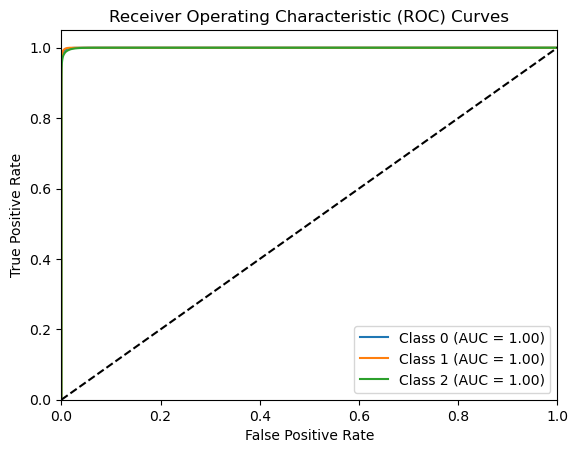

In [148]:
# Binarize the output for ROC curve computation
y_test_binarized = label_binarize(y_test, classes=np.unique(y_test))
n_classes = y_test_binarized.shape[1]


# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_binarized[:, i], y_proba[:, i])
    roc_auc[i] = roc_auc_score(y_test_binarized[:, i], y_proba[:, i])

# Plot ROC curves
plt.figure()
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curves')
plt.legend(loc='lower right')
plt.show()


# Text Data WorkFlow

In [5]:
! pip install pandas

In [18]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_curve, roc_auc_score, classification_report, accuracy_score, precision_score, recall_score, f1_score
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [48]:
hyperspectral_text_path= r'c:\Repos\Data\ML_repo_geo\Randomhyperspectral_text.txt'


In [58]:
with open(hyperspectral_text_path, 'r') as file:
    content = file.read()

200 68 268
Original shape (height, width, bands): (200, 68, 268)
Transposed shape (bands, height, width): (268, 200, 68)


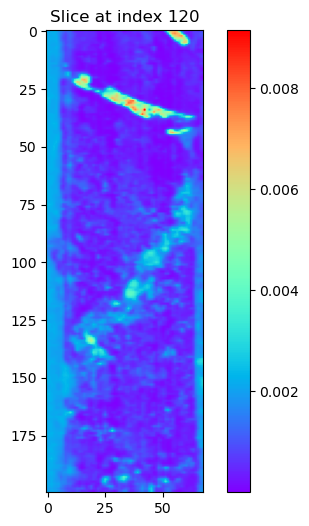

In [50]:
# Read and reshape the data
with open(hyperspectral_text_path, 'r') as swir_text:
    nx, ny, nz = [int(i) for i in swir_text.readline().rstrip().split(',')]
    print(nx, ny, nz)
    swir_text_array = np.zeros((nx * ny * nz), np.float32)
    i = 0
    for line in swir_text:
        swir_text_array[i] = float(line)
        i += 1
    # Reshape the array to (height, width, bands)
    swir_text_array = swir_text_array.reshape(nx, ny, nz)
    print("Original shape (height, width, bands):", swir_text_array.shape)
    
    # Transpose the array to (bands, height, width)
    swir_text_array = swir_text_array.transpose(2, 0, 1)
    print("Transposed shape (bands, height, width):", swir_text_array.shape)

# Visualize a specific slice of the data
slice_index = 120  # Example index
plt.figure(figsize=(6, 6), dpi=100)
plt.imshow(swir_text_array[slice_index, :, :], cmap='rainbow')
plt.title(f'Slice at index {slice_index}')
plt.colorbar()
plt.show()


In [85]:
#remove na 

interpolate_swir=np.zeros_like(swir_text_array)
for band in range(swir_text_array.shape[0]):
    hyper_band=swir_text_array[band,:,:]
    mask=np.isnan(hyper_band)
    hyper_band[mask]=np.mean(hyper_band)
    interpolate_swir[band]=hyper_band

#standarize
from sklearn.preprocessing import MinMaxScaler, RobustScaler, MaxAbsScaler, Normalizer , StandardScaler
scale=StandardScaler()
SWIR_standard_standard=np.array([StandardScaler().fit_transform(band)for band in interpolate_swir])
SWIR_minmax_standard=np.array([MinMaxScaler().fit_transform(band)for band in interpolate_swir])
SWIR_robust_standard=np.array([RobustScaler().fit_transform(band)for band in interpolate_swir])
SWIR_maxabs_standard=np.array([MaxAbsScaler().fit_transform(band)for band in interpolate_swir])
SWIR_normalized_standard=np.array([Normalizer().fit_transform(band)for band in interpolate_swir])


(268, 200, 68)

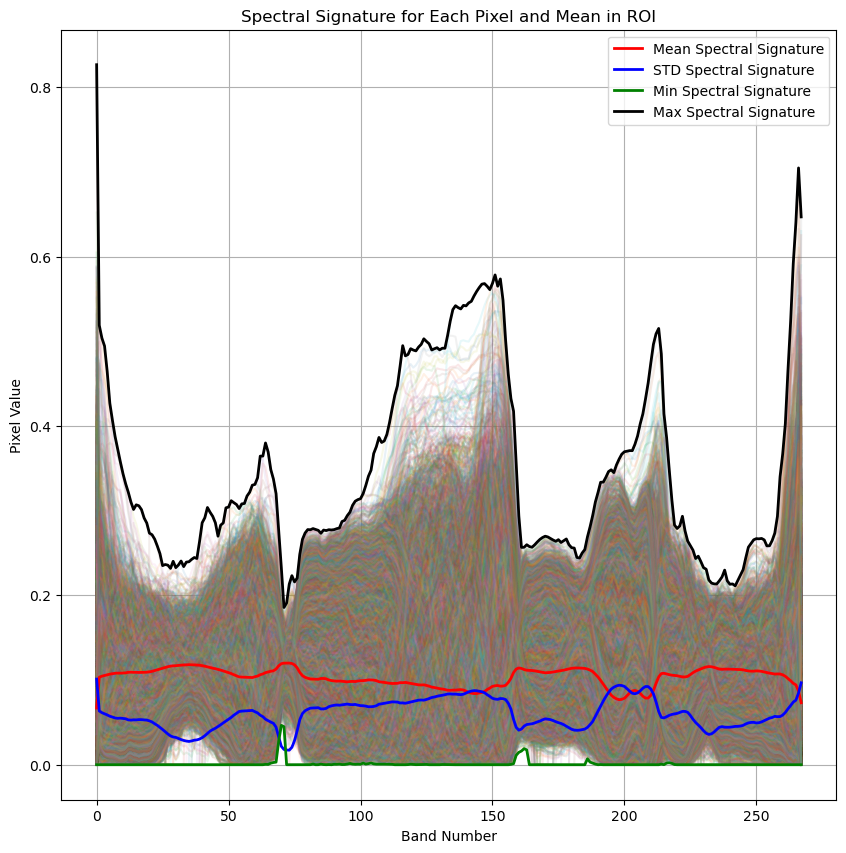

In [96]:
SWIR_normalized=SWIR_normalized_standard

mean_values= np.mean(SWIR_normalized, axis=(1,2))
std_values = np.std(SWIR_normalized, axis=(1, 2))
min_values = np.min(SWIR_normalized, axis=(1, 2))
max_values = np.max(SWIR_normalized, axis=(1, 2))

bands=np.arange(SWIR_normalized.shape[0])

plt.figure(figsize=(10,10))
for i in range(SWIR_normalized.shape[1]):
    for j in range(SWIR_normalized.shape[2]):
        plt.plot(bands, SWIR_normalized[:,i,j], alpha=0.1)
plt.plot(bands, mean_values, color='red', linewidth=2, label='Mean Spectral Signature')
plt.plot(bands, std_values, color='blue', linewidth=2, label='STD Spectral Signature')
plt.plot(bands, min_values, color='green', linewidth=2, label='Min Spectral Signature')
plt.plot(bands, max_values, color='black', linewidth=2, label='Max Spectral Signature')

# Set labels and title
plt.xlabel('Band Number')
plt.ylabel('Pixel Value')
plt.title('Spectral Signature for Each Pixel and Mean in ROI')
plt.legend()
plt.grid(True)
plt.show()


In [123]:
# Dimensionality reduction
from sklearn.decomposition import PCA
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA, FastICA, NMF
from scipy.stats import describe

pca = PCA(n_components=3)
SWIR_pca = pca.fit_transform(Swir_Noise_removal.reshape(268,-1).T)

ica = FastICA(n_components=3)
SWIR_ica = ica.fit_transform(Swir_Noise_removal.reshape(268,-1).T)


SWIR_normalized_nmf=np.maximum(Swir_Noise_removal.reshape(268,-1).T,0)
nmf = NMF(n_components=3, init='random', random_state=0)
SWIR_nmf = nmf.fit_transform(SWIR_normalized_nmf)
# Statistical analysis
pca_stats = describe(SWIR_pca, axis=0)
ica_stats = describe(SWIR_ica, axis=0)
nmf_stats = describe(SWIR_nmf, axis=0)

print("PCA Statistics:", pca_stats)
print("ICA Statistics:", ica_stats)
print("NMF Statistics:", nmf_stats)

PCA Statistics: DescribeResult(nobs=13600, minmax=(array([-1.0301028, -0.8651238, -0.7023385], dtype=float32), array([2.2819283, 1.8776584, 0.8357983], dtype=float32)), mean=array([ 1.4804742e-08, -3.4713544e-08, -4.1526032e-09], dtype=float32), variance=array([0.6391339 , 0.09498257, 0.06344608], dtype=float32), skewness=array([1.006149  , 1.2151724 , 0.25438637], dtype=float32), kurtosis=array([-0.32367563,  4.210803  , -0.16462278], dtype=float32))
ICA Statistics: DescribeResult(nobs=13600, minmax=(array([-2.2034006, -2.5634267, -6.3486986], dtype=float32), array([2.9994903, 2.4245098, 2.3123865], dtype=float32)), mean=array([ 3.8146972e-08, -4.7122732e-08,  8.9757579e-09], dtype=float32), variance=array([1.0000734, 1.0000736, 1.0000737], dtype=float32), skewness=array([ 0.10532087, -0.11447772, -1.6685697 ], dtype=float32), kurtosis=array([-0.74287987, -0.8861699 ,  5.564046  ], dtype=float32))
NMF Statistics: DescribeResult(nobs=13600, minmax=(array([0., 0., 0.], dtype=float32), a



Elbow Method:

Procedure:
Run the K-means algorithm for different values of 
𝑘
k (number of clusters), typically from 1 to some maximum number.
For each 
𝑘
k, compute the sum of squared distances from each point to its assigned cluster center (also known as the Within-Cluster Sum of Squares, WCSS).
Plot the WCSS against the number of clusters 
𝑘
k.
The optimal 
𝑘
k is at the "elbow" point, where the rate of decrease in WCSS sharply slows down.

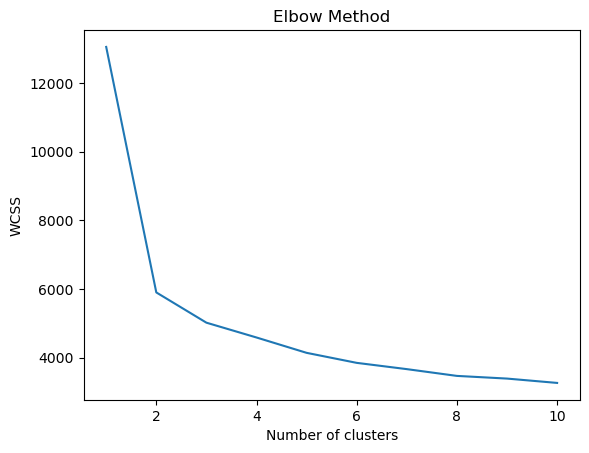

In [180]:
k_means=[]
for k in range(1, 11):
    kmeans=KMeans(n_clusters=k)
    kmeans.fit_predict(Swir_Noise_removal.reshape(268, -1).T)
    k_means.append(kmeans.inertia_)

plt.plot(range(1,11), k_means)
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

Silhouette Method:

k, compute the average silhouette score, which measures how similar an object is to its own cluster compared to other clusters.
The optimal k is the one that maximizes the silhouette score.

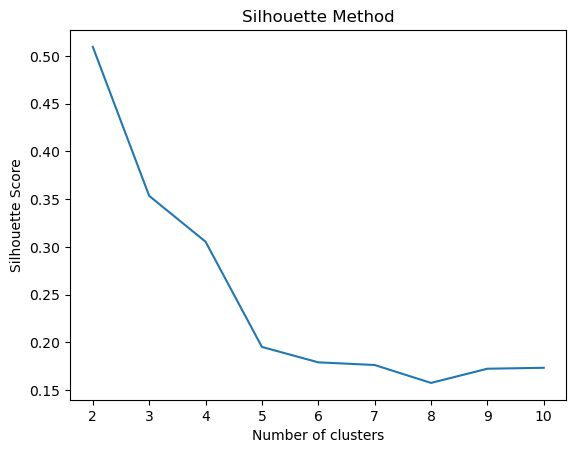

In [181]:
from sklearn.metrics import silhouette_score

silhouette_scores = []
for k in range(2, 11):
    kmeans = KMeans(n_clusters=k, random_state=42)
    cluster_labels = kmeans.fit_predict(Swir_Noise_removal.reshape(268, -1).T)
    silhouette_avg = silhouette_score(Swir_Noise_removal.reshape(268, -1).T, cluster_labels)
    silhouette_scores.append(silhouette_avg)

plt.plot(range(2, 11), silhouette_scores)
plt.title('Silhouette Method')
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette Score')
plt.show()


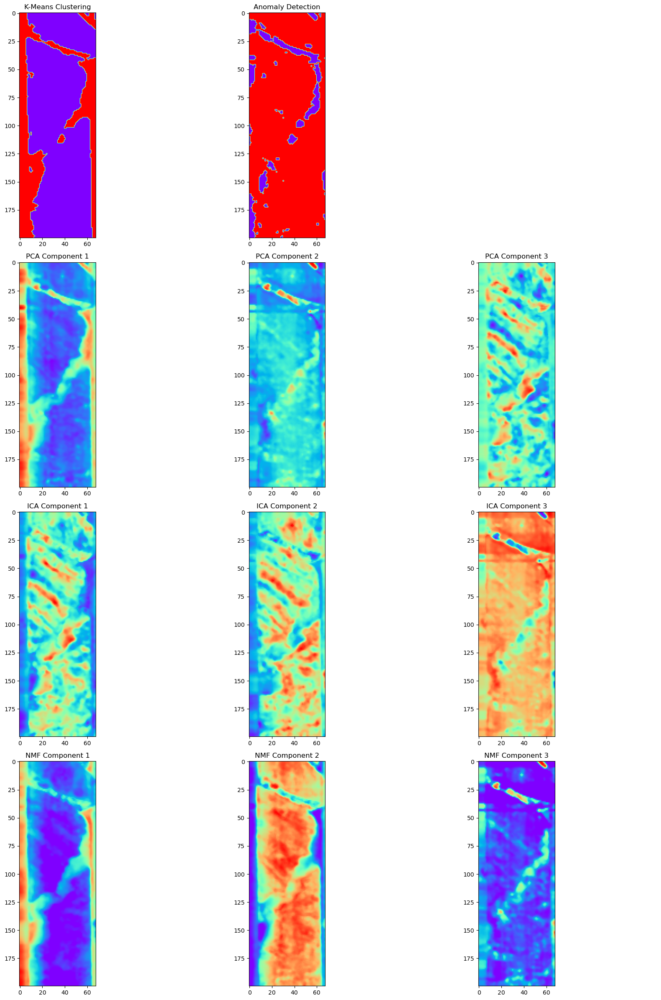

In [182]:
# Clustering
from sklearn.cluster import KMeans 
from sklearn.ensemble import IsolationForest
kmeans = KMeans(n_clusters=2, random_state=0)
clusters = kmeans.fit_predict(Swir_Noise_removal.reshape(268, -1).T)

# Reshape clusters for visualization
clusters_reshaped = clusters.reshape(Swir_Noise_removal.shape[1], Swir_Noise_removal.shape[2])

# Anomaly detection using Isolation Forest
isolation_forest = IsolationForest(contamination=0.1, random_state=0)
anomalies = isolation_forest.fit_predict(Swir_Noise_removal.reshape(268, -1).T)
anomalies_reshaped = anomalies.reshape(Swir_Noise_removal.shape[1], Swir_Noise_removal.shape[2])

# Visualization
fig, axes = plt.subplots(4, 3, figsize=(18, 24))

# Clustering
axes[0, 0].imshow(clusters_reshaped, cmap='rainbow')
axes[0, 0].set_title('K-Means Clustering')

# PCA Components
for i in range(3):
    axes[1, i].imshow(SWIR_pca[:, i].reshape(nx, ny), cmap='rainbow')
    axes[1, i].set_title(f'PCA Component {i+1}')

# ICA Components
for i in range(3):
    axes[2, i].imshow(SWIR_ica[:, i].reshape(nx, ny), cmap='rainbow')
    axes[2, i].set_title(f'ICA Component {i+1}')

# NMF Components
for i in range(3):
    axes[3, i].imshow(SWIR_nmf[:, i].reshape(nx, ny), cmap='rainbow')
    axes[3, i].set_title(f'NMF Component {i+1}')

# Anomalies
axes[0, 1].imshow(anomalies_reshaped, cmap='rainbow')
axes[0, 1].set_title('Anomaly Detection')

axes[0, 2].axis('off')

plt.tight_layout()
plt.show()

In [158]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score
# Train a Linear Regression model
lr_model = LinearRegression()
lr_model.fit(X_train, y_train)

# Predict using the trained model
y_pred_train = lr_model.predict(X_train)
y_pred_test = lr_model.predict(X_test)

# Calculate performance metrics
mse_train = mean_squared_error(y_train, y_pred_train)
r2_train = r2_score(y_train, y_pred_train)
mse_test = mean_squared_error(y_test, y_pred_test)
r2_test = r2_score(y_test, y_pred_test)

print(f"Training MSE: {mse_train:.2f}, Training R2: {r2_train:.2f}")
print(f"Testing MSE: {mse_test:.2f}, Testing R2: {r2_test:.2f}")


Training MSE: 4.52, Training R2: 0.43
Testing MSE: 4.88, Testing R2: 0.40


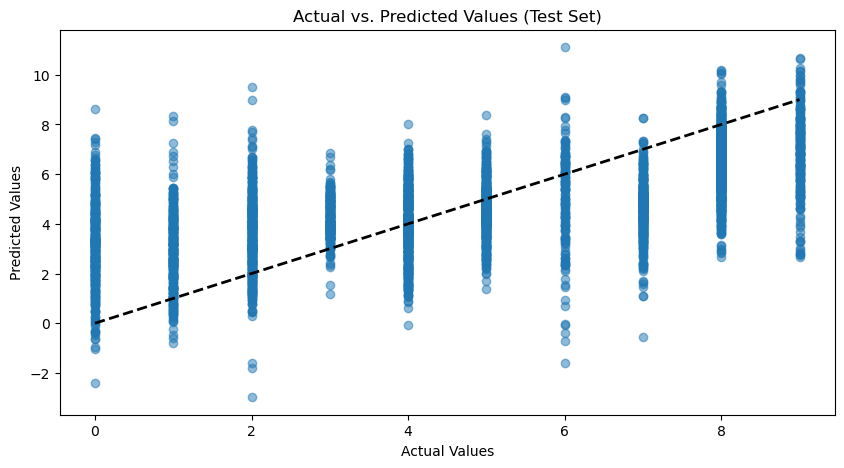

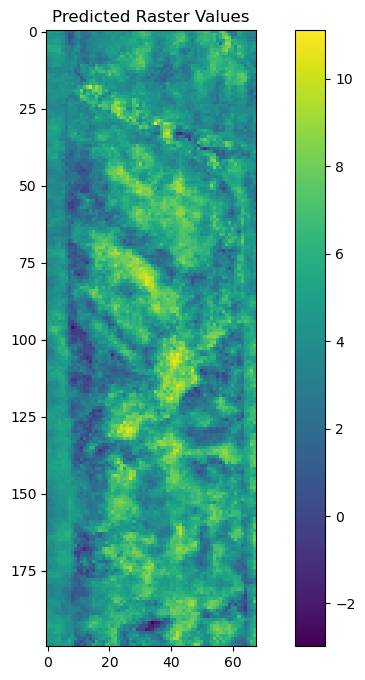

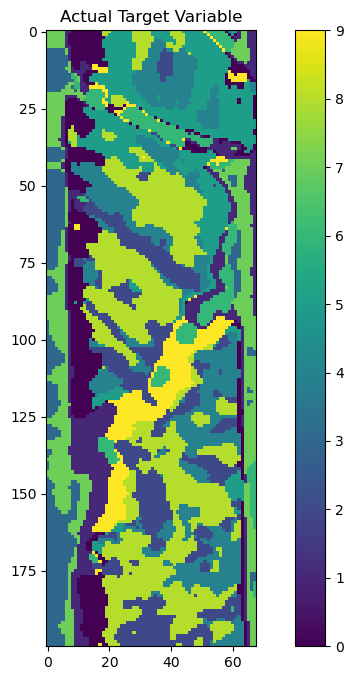

In [163]:
# Plot actual vs. predicted for the test set
plt.figure(figsize=(10, 5))
plt.scatter(y_test, y_pred_test, alpha=0.5)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Actual vs. Predicted Values (Test Set)')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], 'k--', lw=2)
plt.show()

# Reshape predictions back to the original raster shape for visualization
predicted_raster = lr_model.predict(hyperspectral_data).reshape(Swir_Noise_removal.shape[1], Swir_Noise_removal.shape[2])

# Visualize the predicted raster
plt.figure(figsize=(10, 8))
plt.imshow(predicted_raster, cmap='viridis')
plt.title('Predicted Raster Values')
plt.colorbar()
plt.show()

# Visualize the actual target variable for comparison
plt.figure(figsize=(10, 8))
plt.imshow(clusters_reshaped, cmap='viridis')
plt.title('Actual Target Variable')
plt.colorbar()
plt.show()


In [146]:
#random forest and regression modeling 
hyperspectral_data= Swir_Noise_removal.reshape(Swir_Noise_removal.shape[0], -1).T
labels=clusters_reshaped.flatten()
rf= RandomForestClassifier()
X_train, X_test, y_train, y_test = train_test_split(hyperspectral_data,labels, test_size=0.3, random_state=42)
rf.fit(X_train, y_train)

## Predict
y_pred= rf.predict(X_test)
y_prob_pred=rf.predict_proba(X_test)

##Metric
# Compute metrics
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')
# Print classification report and metrics
print("Classification Report:\n", classification_report(y_test, y_pred))
print(f"Accuracy: {accuracy:.2f}")
print(f"Precision: {precision:.2f}")
print(f"Recall: {recall:.2f}")
print(f"F1 Score: {f1:.2f}")



Classification Report:
               precision    recall  f1-score   support

           0       0.95      0.95      0.95       366
           1       0.92      0.95      0.94       320
           2       0.91      0.94      0.92       471
           3       0.99      0.96      0.97       265
           4       0.94      0.92      0.93       549
           5       0.95      0.94      0.94       462
           6       0.94      0.95      0.95       150
           7       0.96      0.96      0.96       394
           8       0.96      0.97      0.97       887
           9       0.95      0.88      0.91       216

    accuracy                           0.95      4080
   macro avg       0.95      0.94      0.94      4080
weighted avg       0.95      0.95      0.95      4080

Accuracy: 0.95
Precision: 0.95
Recall: 0.95
F1 Score: 0.95


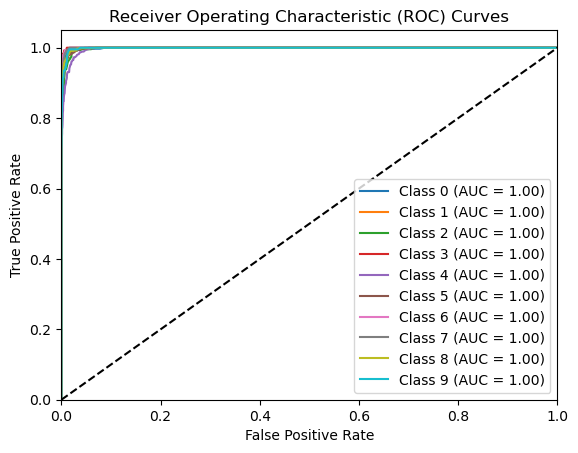

In [155]:
y_test_binarize=label_binarize(y_test,classes=np.unique(y_test))
n_classes = y_test_binarize.shape[1]

fpr=dict()
tpr=dict()
roc_auc={}

for i in range(n_classes):
    fpr[i], tpr[i],_= roc_curve(y_test_binarize[:,i], y_prob_pred[:, i])
    roc_auc[i] = roc_auc_score(y_test_binarize[:, i], y_prob_pred[:, i])

plt.figure()
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curves')
plt.legend(loc='lower right')
plt.show()


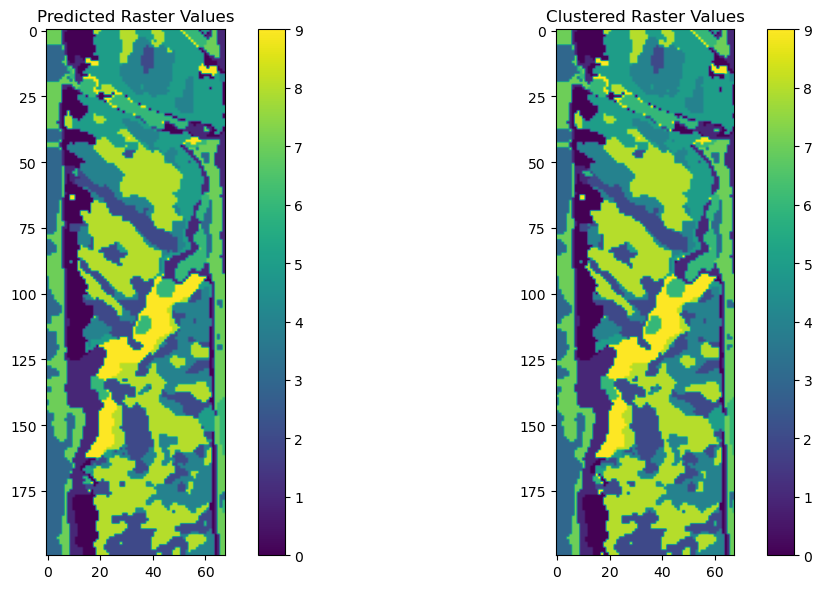

In [170]:
# Reshape predictions back to the original raster shape for visualization
predicted_raster = rf.predict(hyperspectral_data).reshape(Swir_Noise_removal.shape[1], Swir_Noise_removal.shape[2])


fig, axs = plt.subplots(1, 2, figsize=(12, 6))

# First subplot
im0 = axs[0].imshow(predicted_raster, cmap='viridis')
axs[0].set_title('Predicted Raster Values')
fig.colorbar(im0, ax=axs[0], orientation='vertical')

# Second subplot
im1 = axs[1].imshow(clusters_reshaped, cmap='viridis')
axs[1].set_title('Clustered Raster Values')
fig.colorbar(im1, ax=axs[1], orientation='vertical')

plt.tight_layout()


# Geospatial interolation

In [59]:
grid_x, grid_y = np.mgrid[0:3:100j, 0:3:100j]


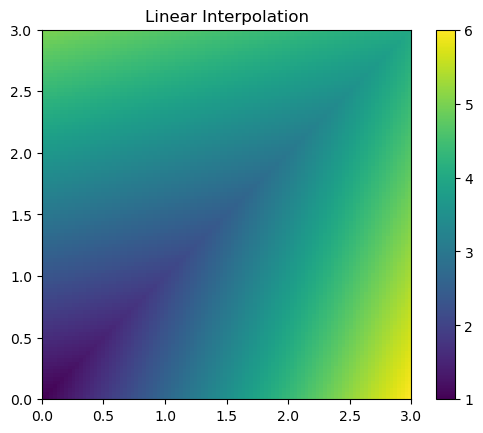

In [174]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import griddata

# Sample data (ensure points are not collinear and cover a reasonable grid)
points = np.array([[0, 0], [1, 1], [2, 2], [3, 3], [0, 3], [3, 0]])
values = np.array([1, 2, 3, 4, 5, 6])
grid_x, grid_y = np.mgrid[0:3:100j, 0:3:100j]
# Perform Linear interpolation
grid_z0 = griddata(points, values, (grid_x, grid_y), method='linear')

# Plot the result
plt.imshow(grid_z0.T, extent=(0, 3, 0, 3), origin='lower', cmap='viridis')
plt.title('Linear Interpolation')
plt.colorbar()
plt.show()


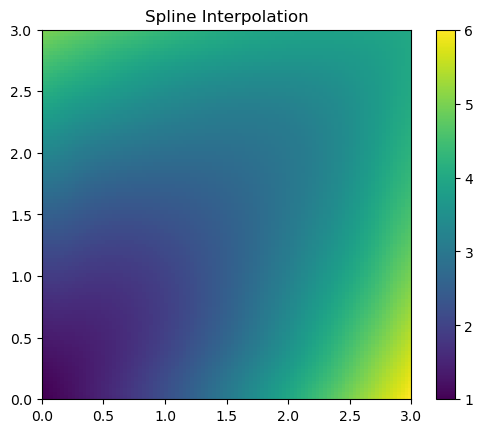

In [175]:

# Perform Spline interpolation
grid_z0 = griddata(points, values, (grid_x, grid_y), method='cubic')

# Plot the result
plt.imshow(grid_z0.T, extent=(0, 3, 0, 3), origin='lower')
plt.title('Spline Interpolation')
plt.colorbar()
plt.show()


In [ ]:
# Perform Nearest Neighbor interpolation
grid_z = griddata((x, y), z, (grid_x, grid_y), method='nearest')

# Plot the result
plt.imshow(grid_z, extent=(0, 3, 0, 3), origin='lower', cmap='viridis')
plt.title('Nearest Neighbor Interpolation')
plt.colorbar()
plt.show()

## CSV file to Raster 

In [61]:
df=pd.read_csv('C:\Repos\Personal_Repos\MLGeoscience\Machine-Learning-Interview\Data\geochemical_data.csv')
x_coords, y_coords = df['X'].values, df['Y'].values
bands = df.drop(columns=['X', 'Y']).values

# Determine raster dimensions
x_min, x_max = x_coords.min(), x_coords.max()
y_min, y_max = y_coords.min(), y_coords.max()
x_dim, y_dim = int(x_max - x_min + 1), int(y_max - y_min + 1)
num_bands = bands.shape[1]

# Initialize raster array with NaNs
raster_array = np.full((num_bands, y_dim, x_dim), np.nan, dtype=np.float32)

# Populate the raster array
for band in range(num_bands):
    for i in range(len(x_coords)):
        x, y = int(x_coords[i] - x_min), int(y_coords[i] - y_min)
        raster_array[band, y, x] = bands[i, band]

,Sample_ID,X,Y,DEPTH,Cu,Au,Zn,Pb
0,1,37.454012,3.142919,642.031646,20.227859,0.507580,47.305932,9.867840
1,2,95.071431,63.641041,84.139965,16.741998,0.432284,57.175423,7.577968
2,3,73.199394,31.435598,161.628714,30.719720,0.597512,65.023571,8.696328
3,4,59.865848,50.857069,898.554189,23.169595,0.485294,50.740948,10.094797
4,5,15.601864,90.756647,606.429060,9.874287,0.417450,66.286155,8.279173
...,...,...,...,...,...,...,...,...
95,96,49.379560,34.920957,522.243260,23.958313,0.568605,50.480849,9.748426
96,97,52.273283,72.595568,769.993553,23.120599,0.605842,52.597225,10.111450
97,98,42.754102,89.711026,215.821027,23.141728,0.324126,40.956834,12.188383
98,99,2.541913,88.708642,622.890476,19.938766,0.381674,56.385925,6.615071


In [118]:
x_coords, y_coords = df['X'].values, df['Y'].values
bands = df.drop(columns=['X', 'Y']).values

# Determine raster dimensions
x_min, x_max = x_coords.min(), x_coords.max()
y_min, y_max = y_coords.min(), y_coords.max()
x_dim, y_dim = int(x_max - x_min + 1), int(y_max - y_min + 1)
num_bands = bands.shape[1]

# Initialize raster array with NaNs
raster_array = np.full((num_bands, y_dim, x_dim), np.nan, dtype=np.float32)

# Populate the raster array
for band in range(num_bands):
    for i in range(len(x_coords)):
        x, y = int(x_coords[i] - x_min), int(y_coords[i] - y_min)
        raster_array[band, y, x] = bands[i, band]

In [102]:
import pandas as pd
import numpy as np
import rasterio
from rasterio.transform import from_origin
from scipy.interpolate import griddata
x_coords, y_coords = df['X'].values, df['Y'].values
bands = df.drop(columns=['X', 'Y']).values

# Determine raster grid dimensions
x_min, x_max = x_coords.min(), x_coords.max()
y_min, y_max = y_coords.min(), y_coords.max()
x_dim, y_dim = int(x_max - x_min + 1), int(y_max - y_min + 1)

# Define grid for interpolation (ensure it matches raster dimensions)
grid_x, grid_y = np.mgrid[y_min:y_max,x_min:x_max]

# Initialize array for interpolated raster
num_bands = bands.shape[1]
interpolated_raster = np.full((num_bands, y_dim, x_dim), np.nan, dtype=np.float32)

# Interpolate for each band
for band in range(num_bands):
    values = bands[:, band]
    # Perform interpolation
    interpolated_band = griddata((x_coords, y_coords), values, (grid_x, grid_y), method='linear')
    interpolated_raster[band, :, :] = interpolated_band


In [ ]:
import geopandas as gpd
import pandas as pd

# Path to the shapefile
shapefile_path = 'path_to_your_shapefile.shp'

# Read the shapefile using geopandas
gdf = gpd.read_file(shapefile_path)

# Convert the GeoDataFrame to a regular DataFrame
# Optionally, you can drop geometry if it's not needed
df = pd.DataFrame(gdf.drop(columns='geometry'))

# Save the DataFrame to a CSV file
csv_path = 'output.csv'
df.to_csv(csv_path, index=False)

print(f"Shapefile converted to CSV and saved to {csv_path}")
